In [1]:
import pandas as pd
import os
from pathlib import Path
from tqdm import tqdm
import numpy as np
import plotly.graph_objects as go

import plotly.io as pio
import plotly.offline as pyo
import plotly.express as px

from scipy import stats


%matplotlib inline

In [2]:
df = pd.read_csv('hellaswag_results.csv')

In [3]:
df.head()

,acc,acc_norm,log_likelihood,num_words,num_bytes,num_bits_per_byte,word_perplexity,byte_perplexity,lang,model,template
0,0.0,0.0,-605.538757,46,743,743,5.211984e+05,2.259157,Marathi,8b,chat
1,0.0,1.0,-541.022888,38,678,678,1.524908e+06,2.221025,Marathi,8b,chat
2,0.0,0.0,-528.661438,37,656,656,1.604218e+06,2.238680,Marathi,8b,chat
3,0.0,1.0,-349.893524,24,282,282,2.145529e+06,3.458231,Marathi,8b,chat
4,1.0,0.0,-518.971436,43,629,629,1.743994e+05,2.282049,Marathi,8b,chat


In [4]:
df['log_word_ppl'] = df.word_perplexity.apply(lambda x : np.log(x))

trained_lang = ['Arabic','Chinese','Czech','Dutch','English',
 'French','German','Greek','Hebrew','Hindi','Indonesian',
 'Italian','Japanese','Korean','Persian','Polish','Portuguese',
 'Romanian','Russian','Spanish','Turkish','Ukrainian','Vietnamese']

df['trained'] = df.lang.apply(lambda x : 'trained' if x in trained_lang else 'untrained')

In [16]:
df.trained.value_counts()

trained
untrained    580608
trained      523212
Name: count, dtype: int64

In [4]:
len(df)

1103820

In [5]:
title_map = {'word_perplexity':'Word Perplexity',
            'log_word_ppl':'Log Word Perplexity',
            'byte_perplexity':'Byte Perplexity',
            'trained':'Trained',
            'acc':'Accuracy',
            'num_words':'Num Words',
             'num_bytes':'Num Bytes',
             'bytes_per_word':'Bytes Per Word',
            'lang':'Language'}

def get_axis_title(num_var):
    return title_map[num_var]

def get_title(group_vars, num_var, y_axis_var, color_var=None):

    if color_var:
        return f"{title_map[num_var]} by {title_map[y_axis_var]} and {title_map[color_var]}"
    else:
        return f"{title_map[num_var]} by {title_map[y_axis_var]}"



## Helper Functions

In [6]:
def scaled_boxplot(df, group_vars, num_var, y_axis_var, color_var=None, layout_var = None, order_by = None):

    if len(group_vars) == 2:
        return boxplot_2cat(df, group_vars, num_var, y_axis_var, color_var, layout_var, order_by)
    elif len(group_vars) == 1:
        return boxplot_1cat(df, group_vars, num_var, y_axis_var, layout_var, order_by)
    else:
        return ValueError('No of grouping vars is >2')
    
        


In [25]:
def boxplot_2cat(df, group_vars, num_var, y_axis_var, color_var, layout_var = None, order_by = None):

    out = df.groupby(group_vars)[num_var].describe().reset_index()
    out['IQR'] = out.apply(lambda x : x['75%'] - x['25%'],axis = 1 )
    out['upperfence'] = out.apply(lambda x : x['75%'] + 1.5* x['IQR'],axis = 1 )
    out['lowerfence'] = out.apply(lambda x : x['75%'] - 1.5* x['IQR'],axis = 1 )

    if order_by:
        out = out.sort_values(order_by)

    fig = go.Figure()
    
    # Add box traces for each 'acc' category
    for color_value in out[color_var].unique():
        plot_df = out[out[color_var] == color_value]
        
        fig.add_trace(go.Box(
            # x=df_filtered['byte_perplexity'],
            y=plot_df[y_axis_var],
            name=f'acc={color_value}',
            orientation='h',
            marker_color='red' if color_value == 0 else 'green',  # Adjust colors as needed,
            boxpoints = False,
            median = plot_df['50%'],
            q1 = plot_df['25%'],
            q3 = plot_df['75%'],
            upperfence=plot_df['upperfence'],
            lowerfence=plot_df['lowerfence'],
            
        ))
    
    if layout_var:
        fig.update_layout(**layout_var)

    return fig

def boxplot_1cat(df, group_vars, num_var, y_axis_var, layout_var = None, order_by = None):

    out = df.groupby(group_vars)[num_var].describe().reset_index()
    out['IQR'] = out.apply(lambda x : x['75%'] - x['25%'],axis = 1 )
    out['upperfence'] = out.apply(lambda x : x['75%'] + 1.5* x['IQR'],axis = 1 )
    out['lowerfence'] = out.apply(lambda x : x['75%'] - 1.5* x['IQR'],axis = 1 )
    if order_by:
        out = out.sort_values(order_by)

    fig = go.Figure()
    
    # Add box traces for each 'acc' category
    plot_df = out
        
    fig.add_trace(go.Box(
        # x=df_filtered['byte_perplexity'],
        y=plot_df[y_axis_var],
        # name=f'acc={color_value}',
        orientation='h',
        # marker_color='blue' if color_value == 0 else 'red',  # Adjust colors as needed,
        boxpoints = False,
        median = plot_df['50%'],
        q1 = plot_df['25%'],
        q3 = plot_df['75%'],
        upperfence=plot_df['upperfence'],
        lowerfence=plot_df['lowerfence'],
        
    ))
    
    if layout_var:
        fig.update_layout(**layout_var)

    return fig


    
def remove_outliers(df, variable, lower_threshold, upper_threshold):
    """
    Remove outliers from a specific variable in a dataframe.
    
    Parameters:
    df (pd.DataFrame): The input dataframe
    variable (str): The name of the variable to remove outliers from
    lower_threshold (float): The lower percentile threshold (e.g., 1 for 1st percentile)
    upper_threshold (float): The upper percentile threshold (e.g., 99 for 99th percentile)
    
    Returns:
    pd.DataFrame: A new dataframe with outliers removed
    """
    # Make a copy of the dataframe to avoid modifying the original
    df_clean = df.copy()
    
    # Calculate the lower and upper bounds
    lower_bound = np.percentile(df_clean[variable], lower_threshold)
    upper_bound = np.percentile(df_clean[variable], upper_threshold)
    
    # Remove outliers
    df_clean = df_clean[(df_clean[variable] >= lower_bound) & 
                        (df_clean[variable] <= upper_bound)]
    
    return df_clean

def remove_outliers_var(df, lower_threshold, upper_threshold):
    """
    Remove outliers from a specific variable in a dataframe.
    
    Parameters:
    df (pd.DataFrame): The input dataframe
    variable (str): The name of the variable to remove outliers from
    lower_threshold (float): The lower percentile threshold (e.g., 1 for 1st percentile)
    upper_threshold (float): The upper percentile threshold (e.g., 99 for 99th percentile)
    
    Returns:
    pd.DataFrame: A new dataframe with outliers removed
    """
    # Make a copy of the dataframe to avoid modifying the original
    df_clean = df.copy()
    
    # Calculate the lower and upper bounds
    lower_bound = np.percentile(df_clean, lower_threshold)
    upper_bound = np.percentile(df_clean, upper_threshold)
    
    # Remove outliers
    df_clean = df_clean[(df_clean >= lower_bound) & 
                        (df_clean <= upper_bound)]
    
    return df_clean

In [8]:
def compare_means(df, binary_var, continuous_var, display = True, remove_outliers = None):
    # Split the dataframe
    if remove_outliers:
        df = remove_outliers(df, continuous_var)
   
    group1 = df[df[binary_var] == 0][continuous_var]
    group2 = df[df[binary_var] == 1][continuous_var]
    
    # Perform the t-test
    t_tstat, t_pval = stats.ttest_ind(group1, group2)
    mw_tstat, mw_pval = stats.mannwhitneyu(group1, group2, alternative='two-sided')

    # if display:
    #     print(f"T-statistic: {t_statistic}")
    #     print(f"P-value: {p_value}")
        
    #     # Print means for each group
    #     print(f"Mean for group 0: {group1.mean()}")
    #     print(f"Mean for group 1: {group2.mean()}")

    
    
    return True if mw_pval < 0.05 else False, True if t_pval < 0.05 else False, mw_pval, t_pval, group1.mean(), group2.mean(), group1.median(), group2.median(), np.percentile(group1, 25), np.percentile(group2, 25), np.percentile(group1, 75), np.percentile(group2, 75)
    

## Visualization focusing on Model Performance

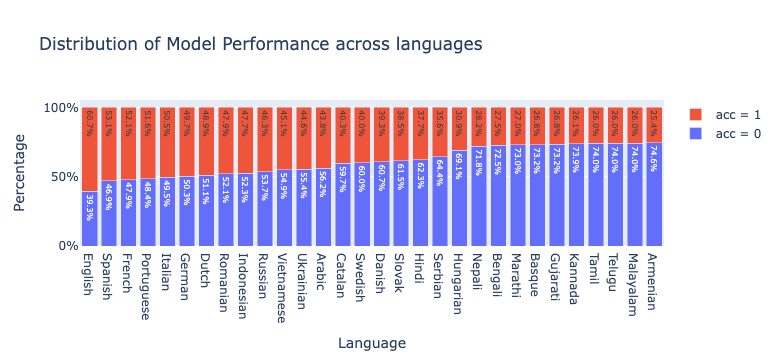

In [5]:
result = df.groupby('lang')['acc'].value_counts(normalize=True).unstack()
result = result.sort_values(by=1, ascending=False)

# Create the stacked bar chart
fig = go.Figure()

for acc_value in [0, 1]:
    fig.add_trace(go.Bar(
        x=result.index,
        y=result[acc_value],
        name=f'acc = {acc_value}',
        text=[f'{value:.1%}' for value in result[acc_value]],
        textposition='auto'
    ))

# Update layout
fig.update_layout(
    title='Distribution of Model Performance across languages',
    xaxis_title='Language',
    yaxis_title='Percentage',
    barmode='stack',
    yaxis=dict(tickformat='.0%')
)

# Show the plot
fig.show()

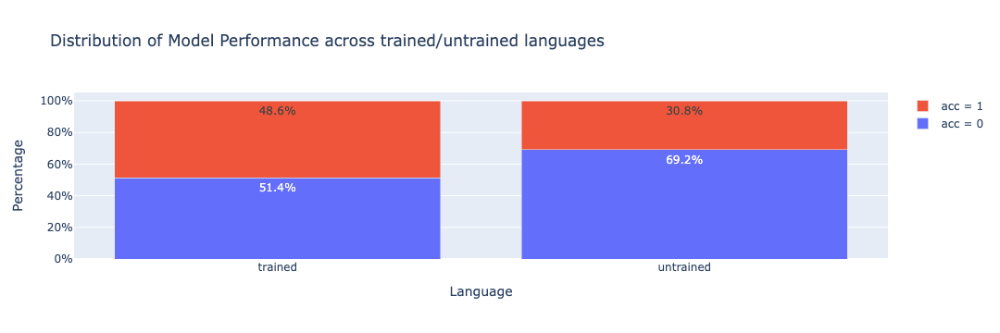

In [17]:
result = df.groupby('trained')['acc'].value_counts(normalize=True).unstack()
result = result.sort_values(by=1, ascending=False)

# Create the stacked bar chart
fig = go.Figure()

for acc_value in [0, 1]:
    fig.add_trace(go.Bar(
        x=result.index,
        y=result[acc_value],
        name=f'acc = {acc_value}',
        text=[f'{value:.1%}' for value in result[acc_value]],
        textposition='auto'
    ))

# Update layout
fig.update_layout(
    title='Distribution of Model Performance across trained/untrained languages',
    xaxis_title='Language',
    yaxis_title='Percentage',
    barmode='stack',
    yaxis=dict(tickformat='.0%')
)

# Show the plot
fig.show()

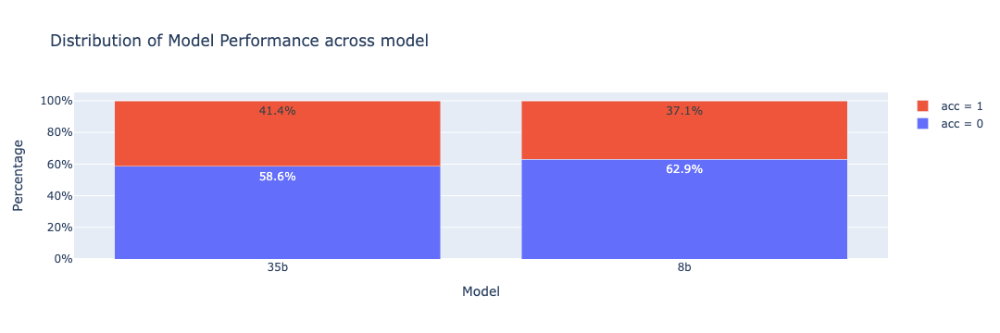

In [41]:
result = df.groupby('model')['acc'].value_counts(normalize=True).unstack()
result = result.sort_values(by=1, ascending=False)

# Create the stacked bar chart
fig = go.Figure()

for acc_value in [0, 1]:
    fig.add_trace(go.Bar(
        x=result.index,
        y=result[acc_value],
        name=f'acc = {acc_value}',
        text=[f'{value:.1%}' for value in result[acc_value]],
        textposition='auto'
    ))

# Update layout
fig.update_layout(
    title='Distribution of Model Performance across model',
    xaxis_title='Model',
    yaxis_title='Percentage',
    barmode='stack',
    yaxis=dict(tickformat='.0%')
)

# Show the plot
fig.show()

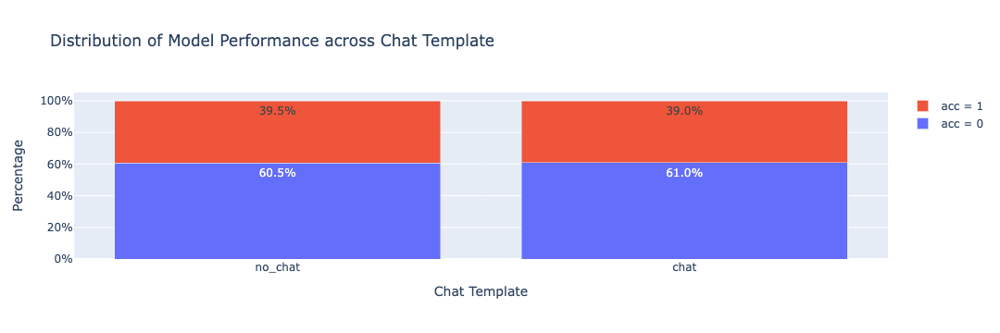

In [42]:
result = df.groupby('template')['acc'].value_counts(normalize=True).unstack()
result = result.sort_values(by=1, ascending=False)

# Create the stacked bar chart
fig = go.Figure()

for acc_value in [0, 1]:
    fig.add_trace(go.Bar(
        x=result.index,
        y=result[acc_value],
        name=f'acc = {acc_value}',
        text=[f'{value:.1%}' for value in result[acc_value]],
        textposition='auto'
    ))

# Update layout
fig.update_layout(
    title='Distribution of Model Performance across Chat Template',
    xaxis_title='Chat Template',
    yaxis_title='Percentage',
    barmode='stack',
    yaxis=dict(tickformat='.0%')
)

# Show the plot
fig.show()

### Model performance against log likelihood

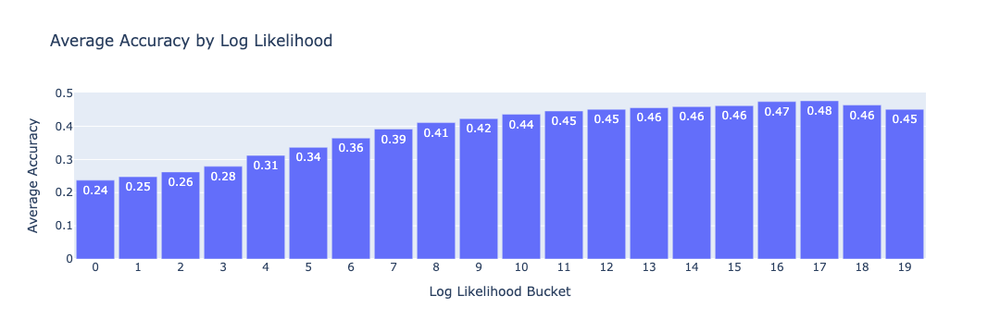

In [53]:
df['likelihood_bucket'] = pd.qcut(df.log_likelihood, q=20, labels = [str(i) for i in range(20)])
acc_mean = df.groupby('likelihood_bucket')['acc'].agg(['mean','count']).reset_index()

# Create the bar plot
fig = go.Figure(data=[go.Bar(
    x=acc_mean['likelihood_bucket'],
    y=acc_mean['mean'],
    text=acc_mean['mean'].round(2),
    textposition='auto',
)])

fig.update_layout(
    title='Average Accuracy by Log Likelihood',
    xaxis_title='Log Likelihood Bucket',
    yaxis_title='Average Accuracy',
    bargap=0.1
)

fig.show()


### Model performance against num of words

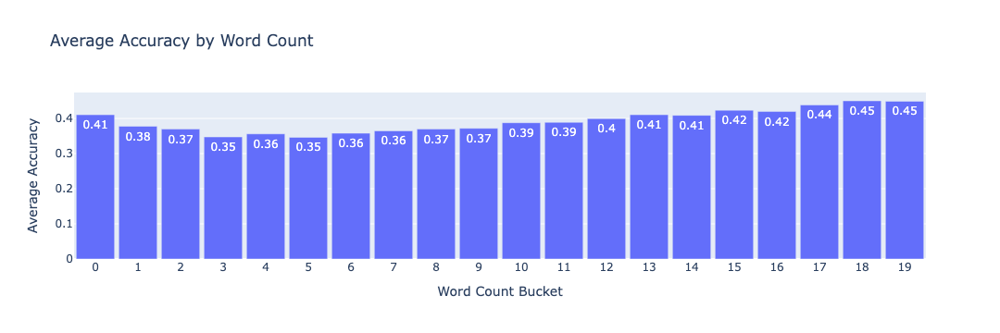

In [55]:
df['wordcount_bucket'] = pd.qcut(df.num_words, q=20, labels = [str(i) for i in range(20)])
acc_mean = df.groupby('wordcount_bucket')['acc'].agg(['mean','count']).reset_index()

# Create the bar plot
fig = go.Figure(data=[go.Bar(
    x=acc_mean['wordcount_bucket'],
    y=acc_mean['mean'],
    text=acc_mean['mean'].round(2),
    textposition='auto',
)])

fig.update_layout(
    title='Average Accuracy by Word Count',
    xaxis_title='Word Count Bucket',
    yaxis_title='Average Accuracy',
    bargap=0.1
)

fig.show()


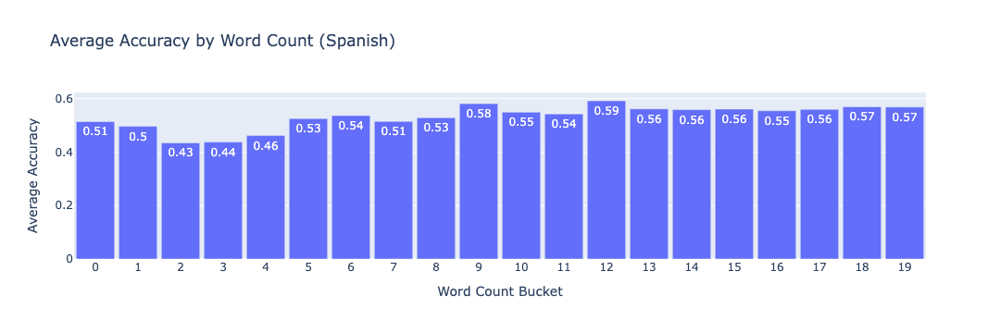

In [60]:
sub = df[df.lang=='Spanish'].copy()
sub['wordcount_bucket'] = pd.qcut(sub.num_words, q=20, labels = [str(i) for i in range(20)])
acc_mean = sub.groupby('wordcount_bucket')['acc'].agg(['mean','count']).reset_index()

# Create the bar plot
fig = go.Figure(data=[go.Bar(
    x=acc_mean['wordcount_bucket'],
    y=acc_mean['mean'],
    text=acc_mean['mean'].round(2),
    textposition='auto',
)])

fig.update_layout(
    title='Average Accuracy by Word Count (Spanish)',
    xaxis_title='Word Count Bucket',
    yaxis_title='Average Accuracy',
    bargap=0.1
)

fig.show()


## Visualization focusing on Num Words/ Bytes

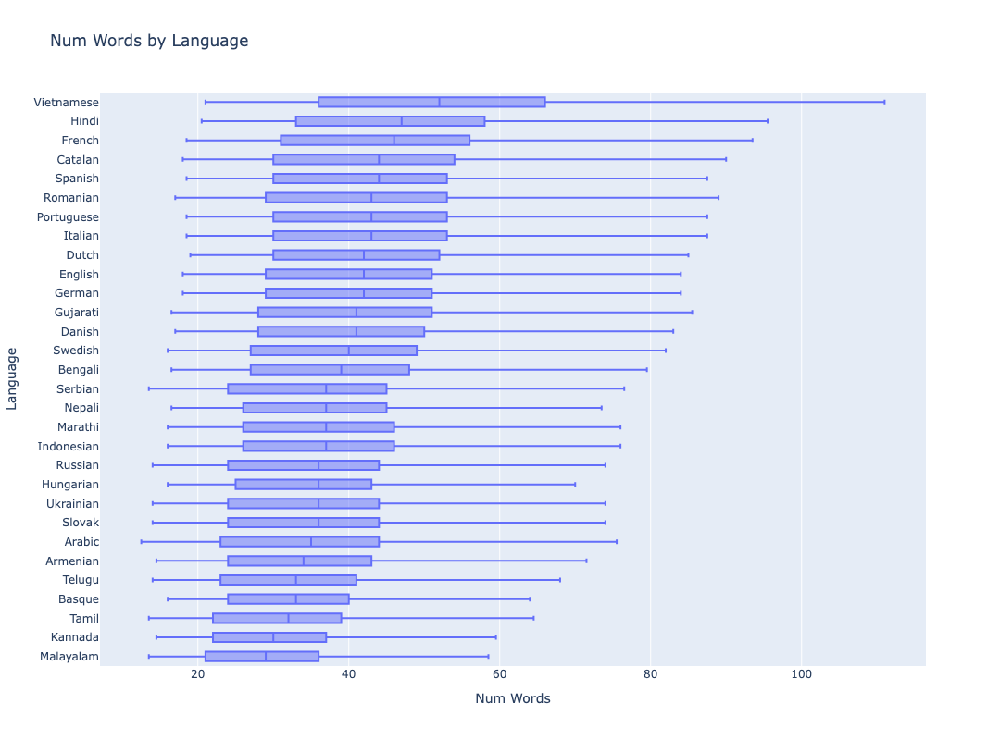

In [68]:
group_vars = ['lang']
num_var = 'num_words'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':get_title(group_vars, num_var, y_axis_var, color_var),
            'xaxis_title':get_axis_title(num_var),
            'yaxis_title':get_axis_title(y_axis_var),
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

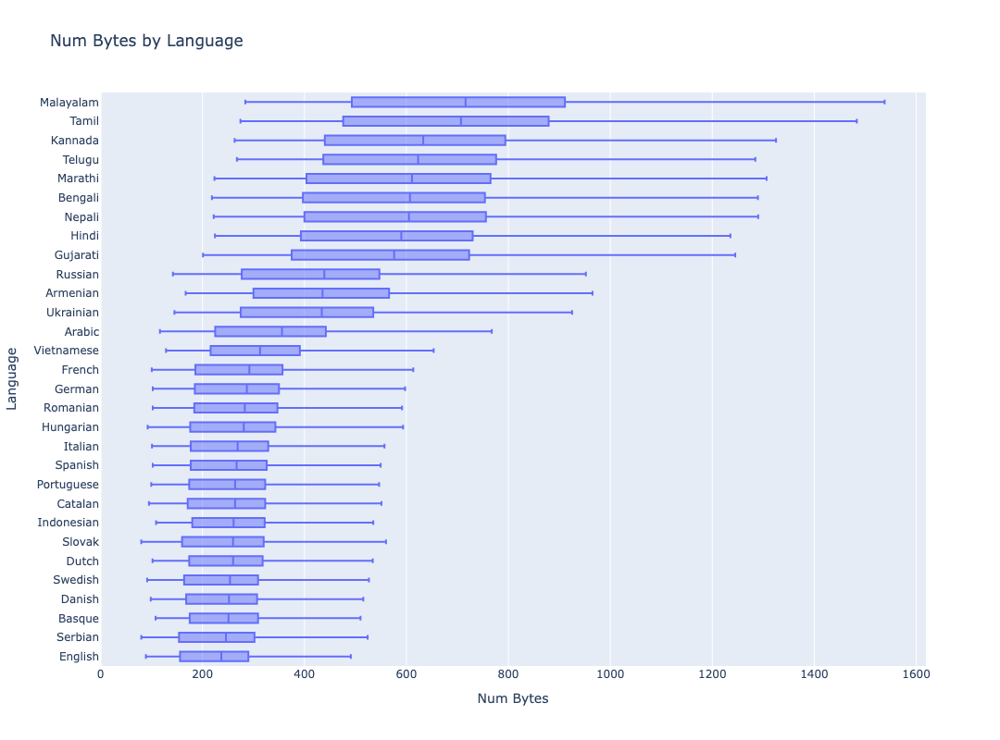

In [70]:
group_vars = ['lang']
num_var = 'num_bytes'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':get_title(group_vars, num_var, y_axis_var, color_var),
            'xaxis_title':get_axis_title(num_var),
            'yaxis_title':get_axis_title(y_axis_var),
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

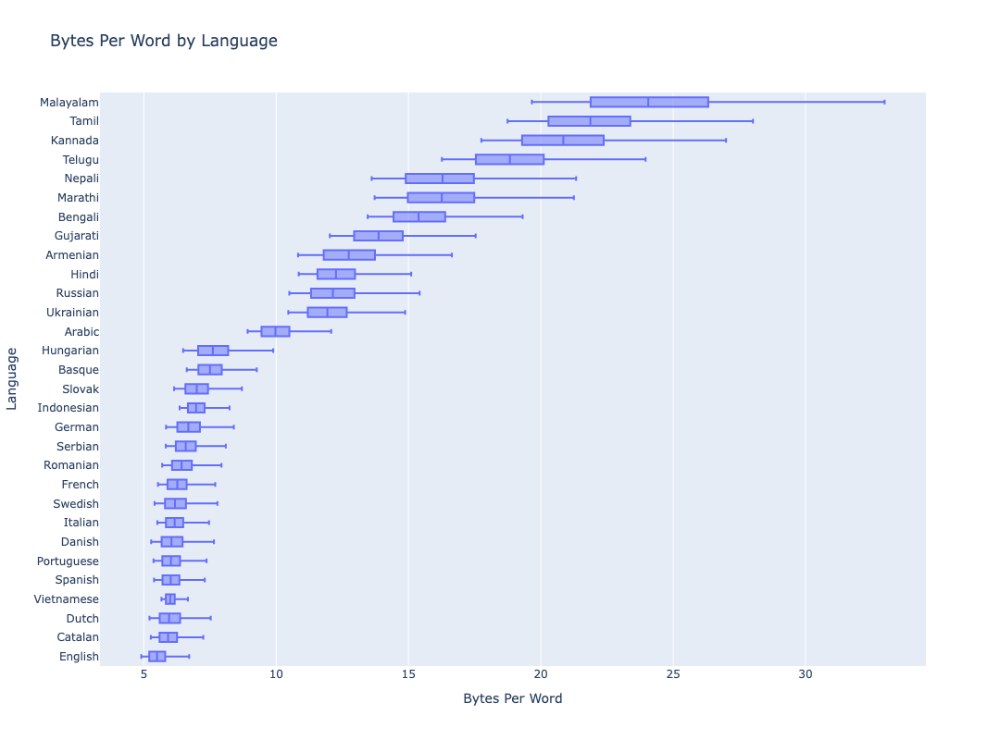

In [73]:
df['bytes_per_word'] = df.apply(lambda x : x.num_bytes/x.num_words, axis = 1)

group_vars = ['lang']
num_var = 'bytes_per_word'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':get_title(group_vars, num_var, y_axis_var, color_var),
            'xaxis_title':get_axis_title(num_var),
            'yaxis_title':get_axis_title(y_axis_var),
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

## Visualization focusing on Byte Perplexity

In [ ]:
scaled_boxplot(df, group_vars=['acc'], num_var='byte_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

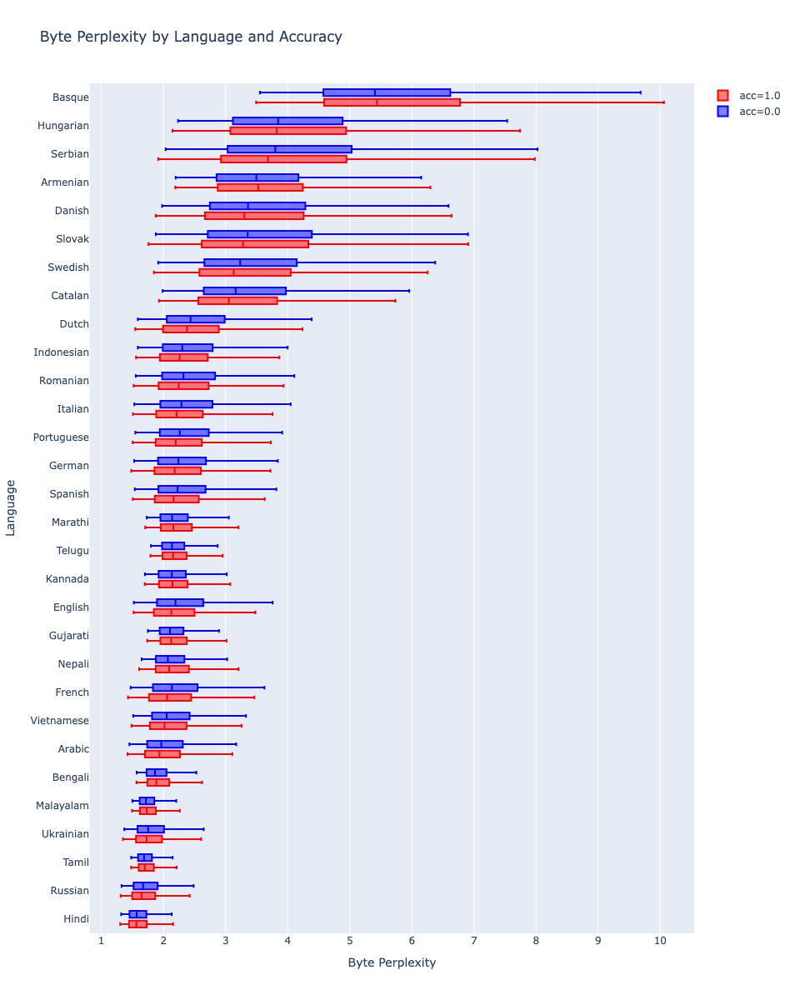

In [143]:
scaled_boxplot(df, group_vars=['lang','acc'], num_var = 'byte_perplexity', y_axis_var='lang',color_var='acc',
               layout_var={'title':'Byte Perplexity by Language and Accuracy',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 1200},
               order_by = '50%'
)

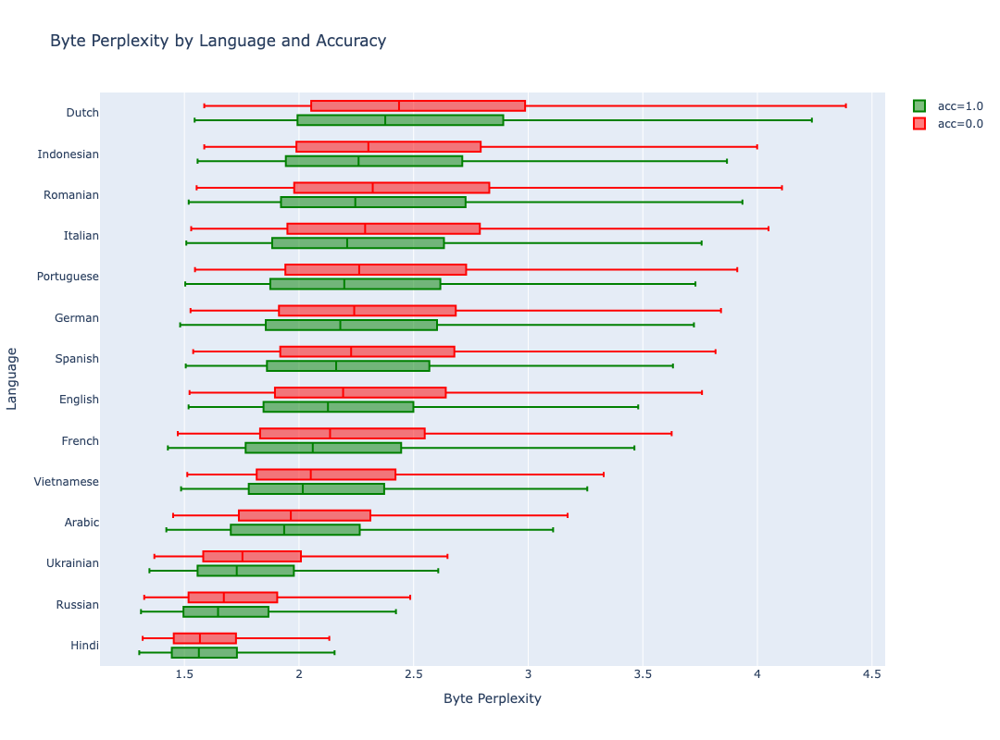

In [31]:

scaled_boxplot(df[df.trained == 'trained'], group_vars=['lang','acc'], num_var = 'byte_perplexity', y_axis_var='lang',color_var='acc',
               layout_var={'title':'Byte Perplexity by Language and Accuracy',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

## Visualization focusing on Word Perplexity

### Byte Perplexity by Model

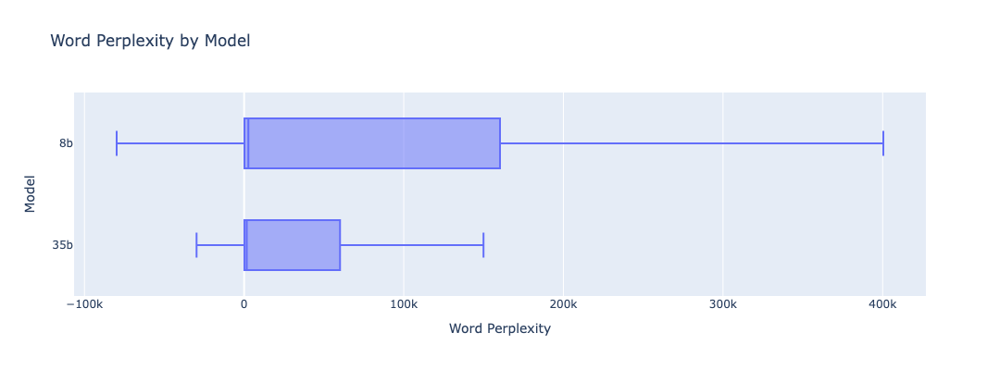

In [19]:
scaled_boxplot(df, group_vars=['model'], num_var='word_perplexity',y_axis_var='model', layout_var={'title':'Word Perplexity by Model',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Model',
            'boxmode':'group',
            'height': 400} )


# fig = px.box(df, x="byte_perplexity", y="model", title="Distribution of Byte Perplexity by Model")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title="Model")
# fig.show()

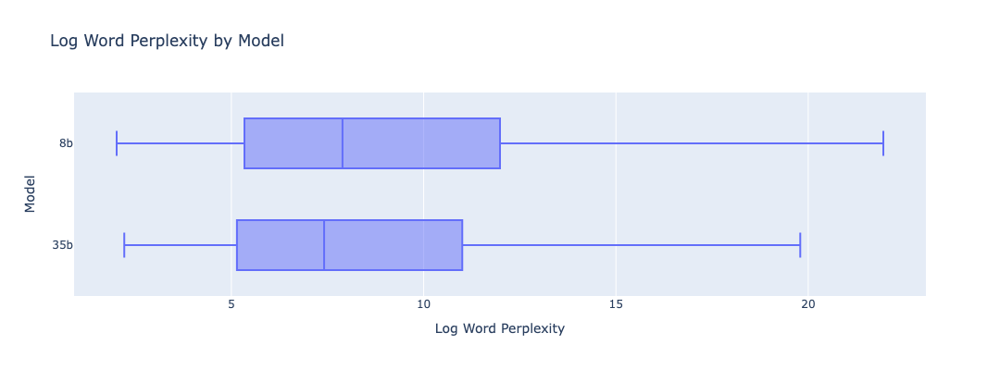

In [18]:
scaled_boxplot(df, group_vars=['model'], num_var='log_word_ppl',y_axis_var='model', layout_var={'title':'Log Word Perplexity by Model',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Model',
            'boxmode':'group',
            'height': 400} )


# fig = px.box(df, x="byte_perplexity", y="model", title="Distribution of Byte Perplexity by Model")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title="Model")
# fig.show()

### Word Perplexity by Chat Template

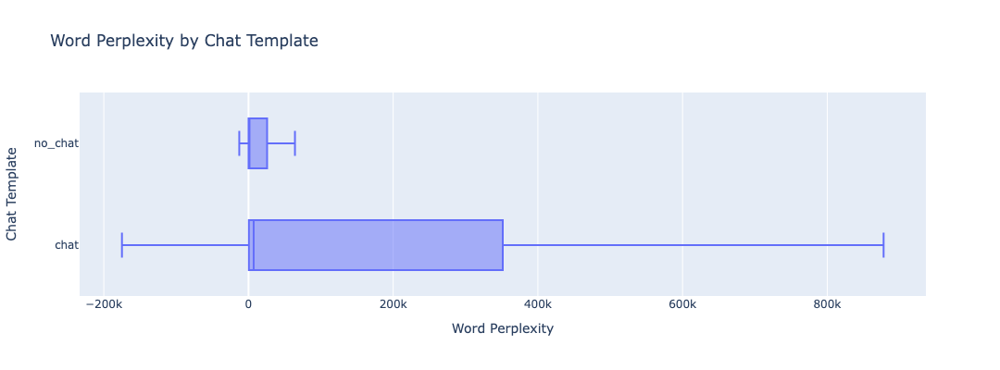

In [20]:
scaled_boxplot(df, group_vars=['template'], num_var='word_perplexity',y_axis_var='template', layout_var={'title':'Word Perplexity by Chat Template',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Chat Template',
            'boxmode':'group',
            'height': 400} )


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

### Word Perplexity by Language

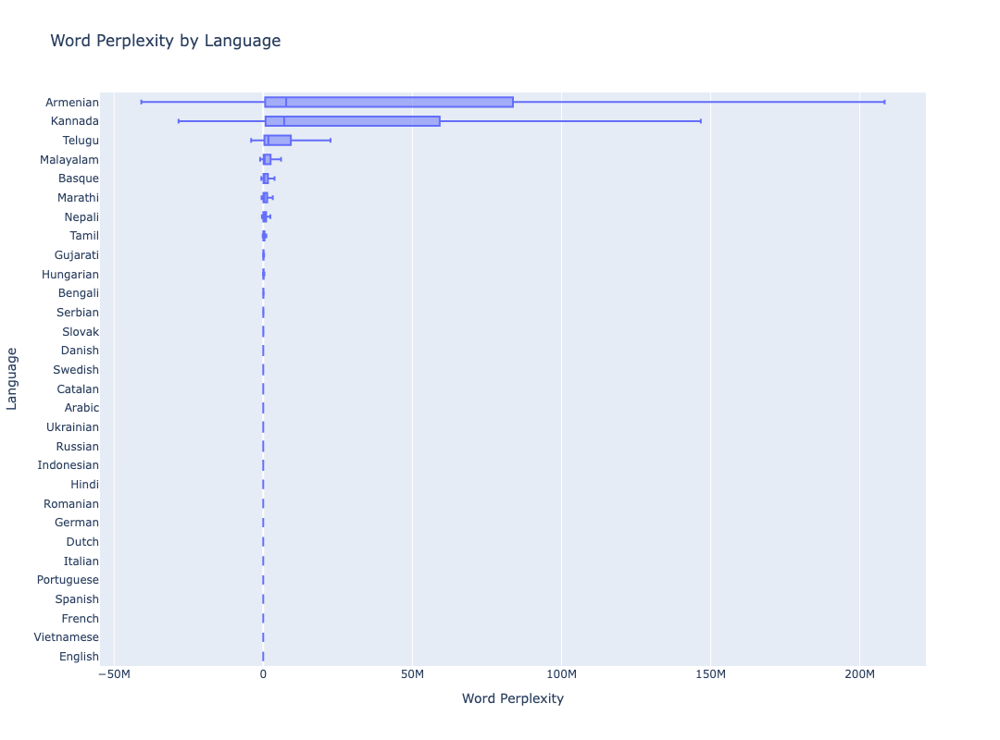

In [21]:
scaled_boxplot(df, group_vars=['lang'], num_var='word_perplexity',y_axis_var='lang', layout_var={'title':'Word Perplexity by Language',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
              order_by='50%')


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

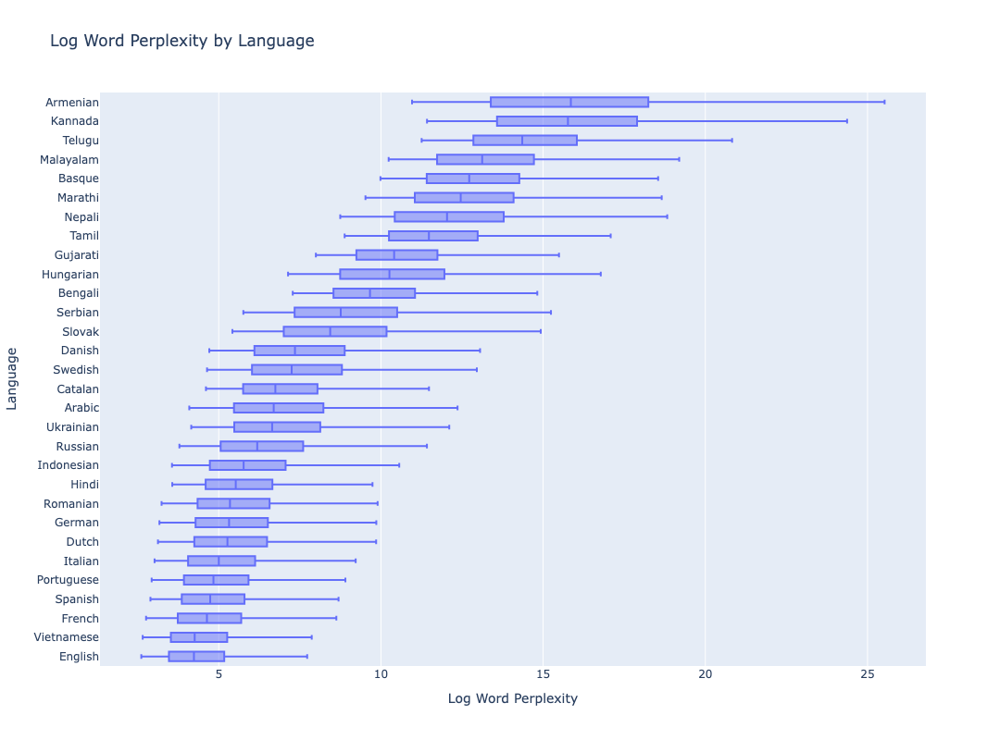

In [22]:
scaled_boxplot(df, group_vars=['lang'], num_var='log_word_ppl',y_axis_var='lang', layout_var={'title':'Log Word Perplexity by Language',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
              order_by='50%')


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

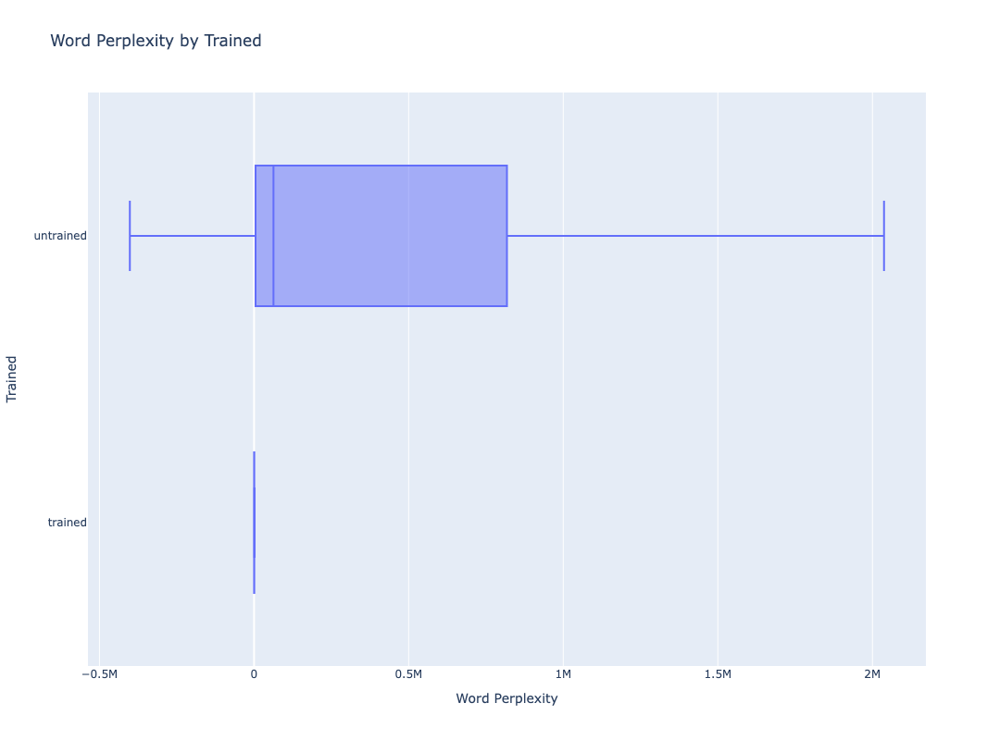

In [29]:
scaled_boxplot(df, group_vars=['trained'], num_var='word_perplexity',y_axis_var='trained', layout_var={'title':'Word Perplexity by Trained',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Trained',
            'boxmode':'group',
            'height': 800},
              order_by='50%')


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

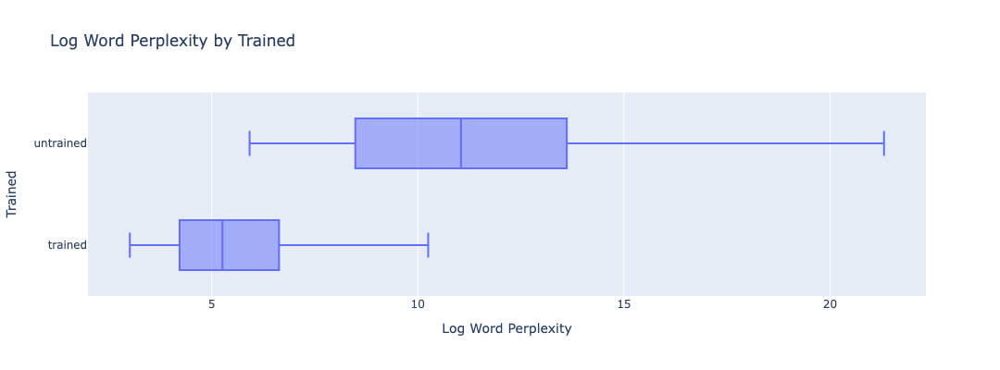

In [27]:
scaled_boxplot(df, group_vars=['trained'], num_var='log_word_ppl',y_axis_var='trained', layout_var={'title':'Log Word Perplexity by Trained',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Trained',
            'boxmode':'group',
            'height': 400},
              order_by='50%')


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

### Word Perplexity by Accuracy

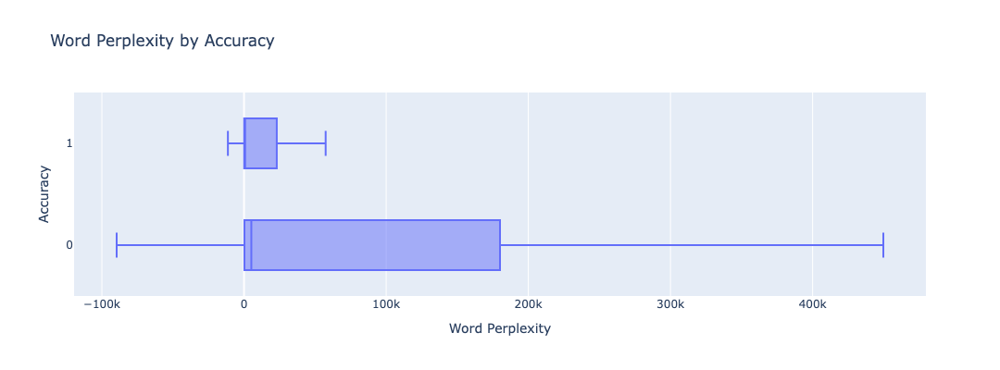

In [23]:
scaled_boxplot(df, group_vars=['acc'], num_var='word_perplexity',y_axis_var='acc', layout_var={'title':'Word Perplexity by Accuracy',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

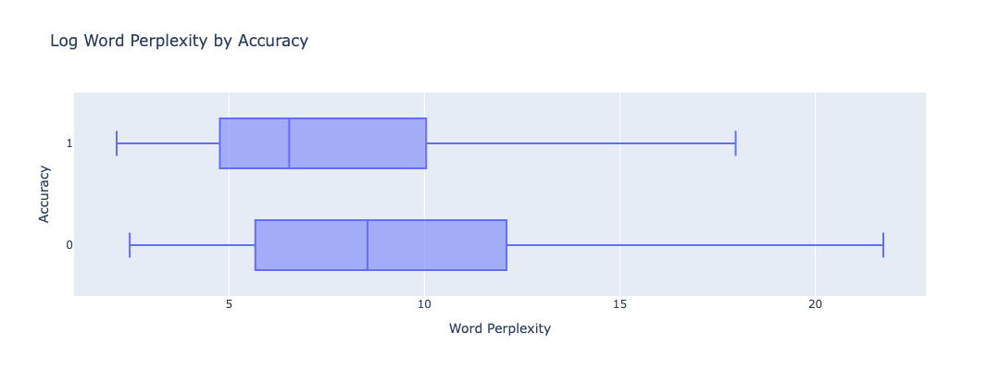

In [24]:
scaled_boxplot(df, group_vars=['acc'], num_var='log_word_ppl',y_axis_var='acc', layout_var={'title':'Log Word Perplexity by Accuracy',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )


# fig = px.box(df, x="byte_perplexity", y="template", title="Distribution of Byte Perplexity by Chat Template")
# fig.update_layout(xaxis_title="Byte Perplexity", yaxis_title=" Chat Template")
# fig.show()

### Word Perplexity vs Language vs Acc

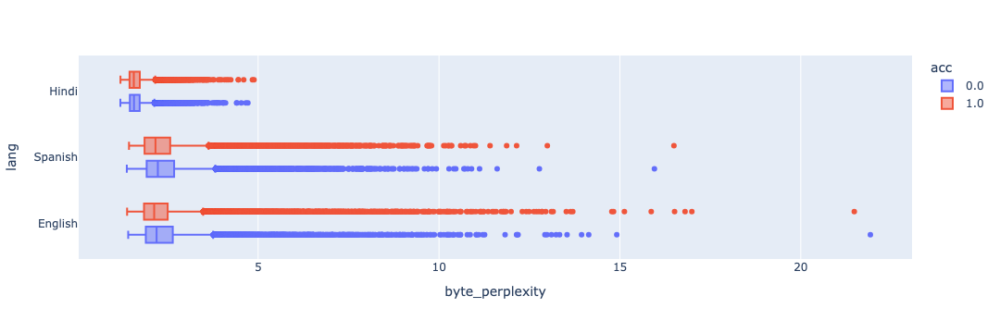

In [23]:
df_  = df[df.lang.isin(['English','Hindi','Spanish'])]
px.box(df_, y="lang", x="byte_perplexity", color="acc", orientation = 'h')

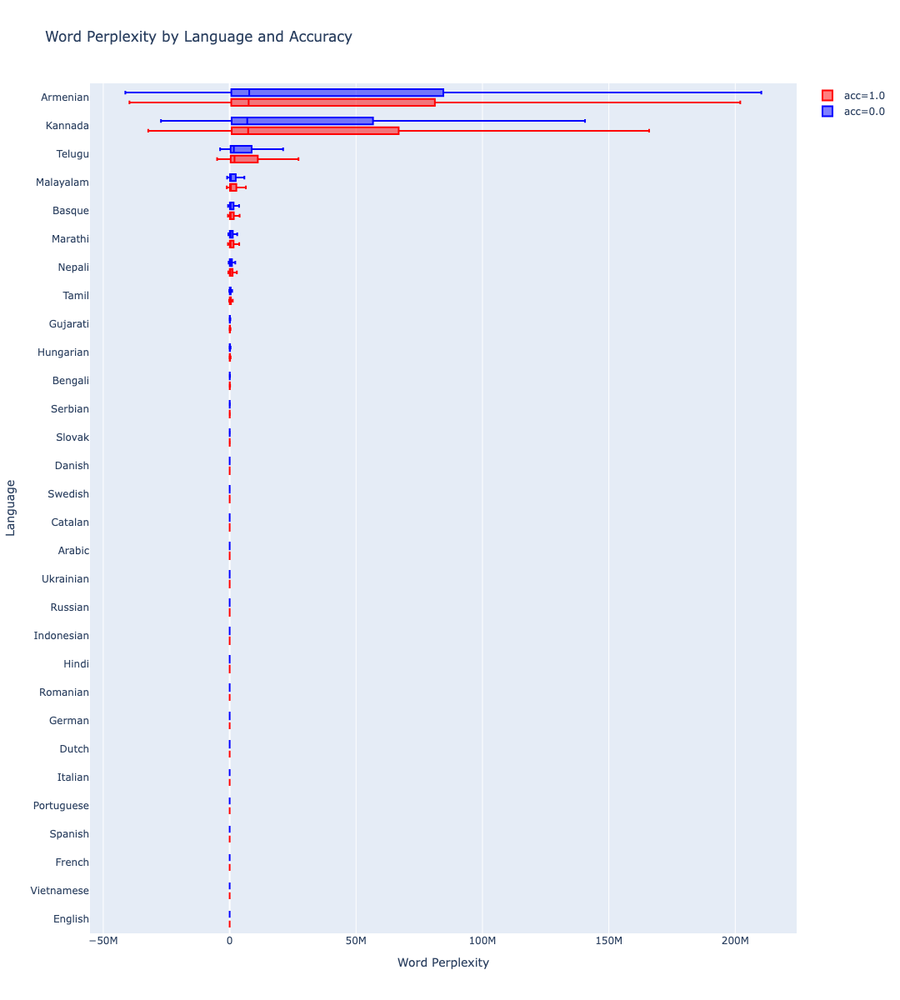

In [35]:
scaled_boxplot(df, group_vars=['lang','acc'], num_var = 'word_perplexity', y_axis_var='lang',color_var='acc',
               layout_var={'title':'Word Perplexity by Language and Accuracy',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 1200},
               order_by = '50%'
)

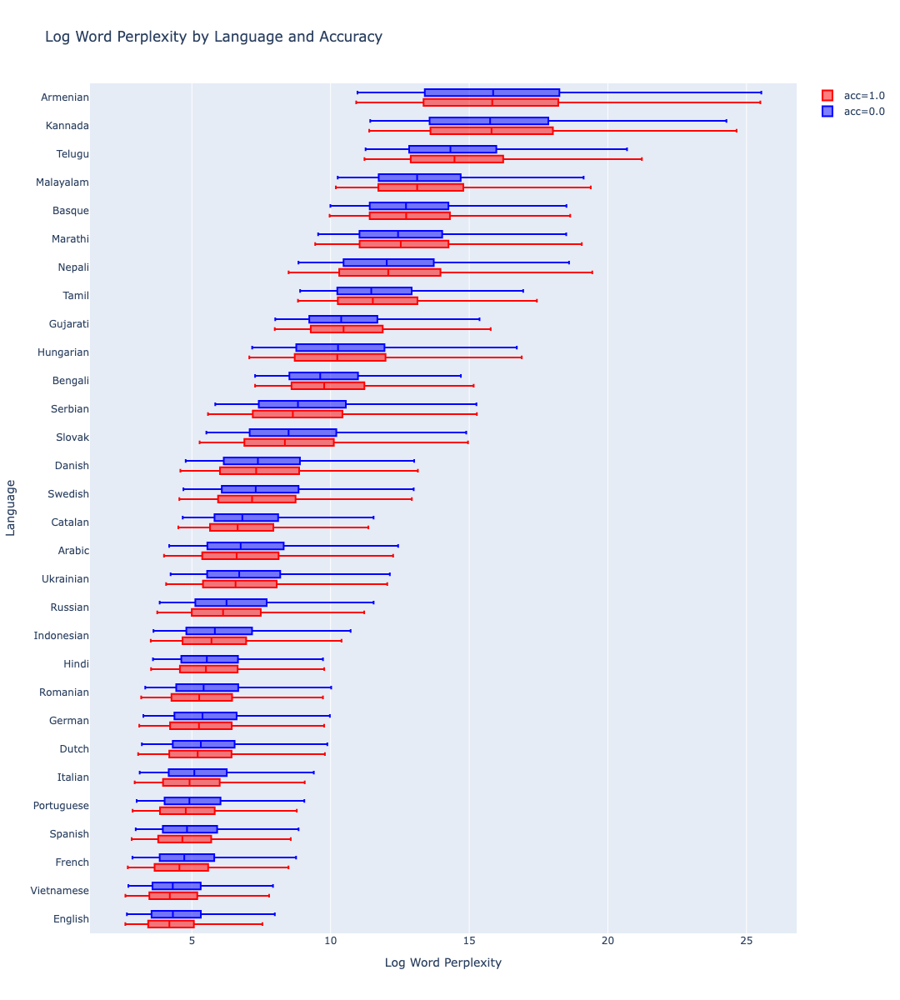

In [34]:
scaled_boxplot(df, group_vars=['lang','acc'], num_var = 'log_word_ppl', y_axis_var='lang',color_var='acc',
               layout_var={'title':'Log Word Perplexity by Language and Accuracy',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 1200
            },
               order_by = '50%'
)

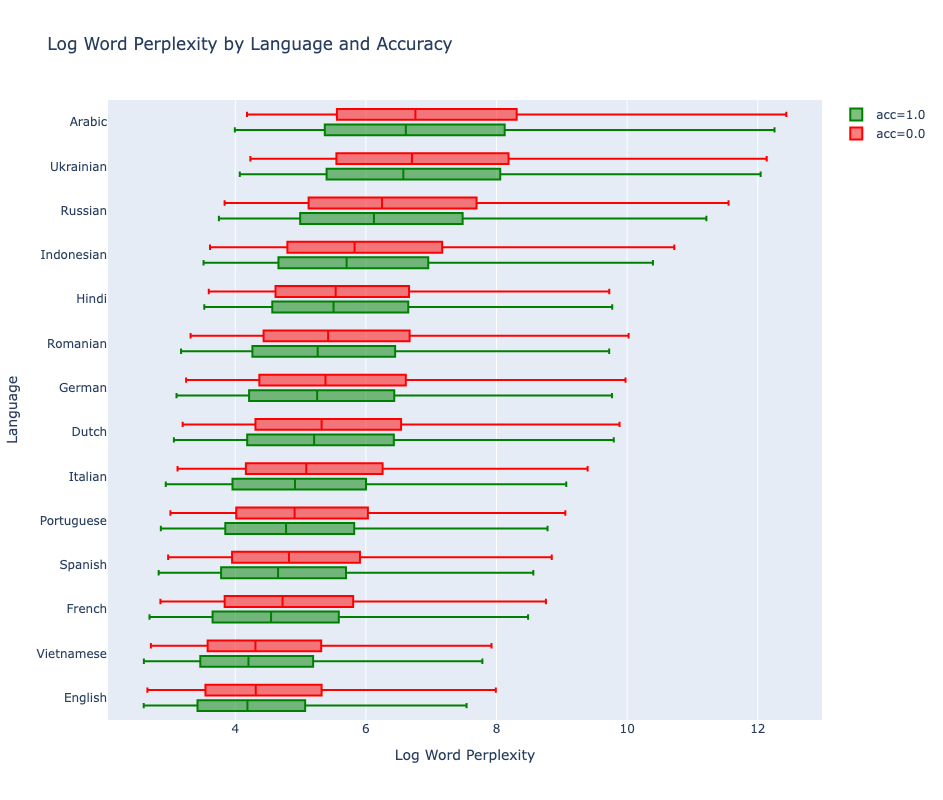

In [30]:
scaled_boxplot(df[df.trained == 'trained'], group_vars=['lang','acc'], num_var = 'log_word_ppl', y_axis_var='lang',color_var='acc',
               layout_var={'title':'Log Word Perplexity by Language and Accuracy',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800
            },
               order_by = '50%'
)

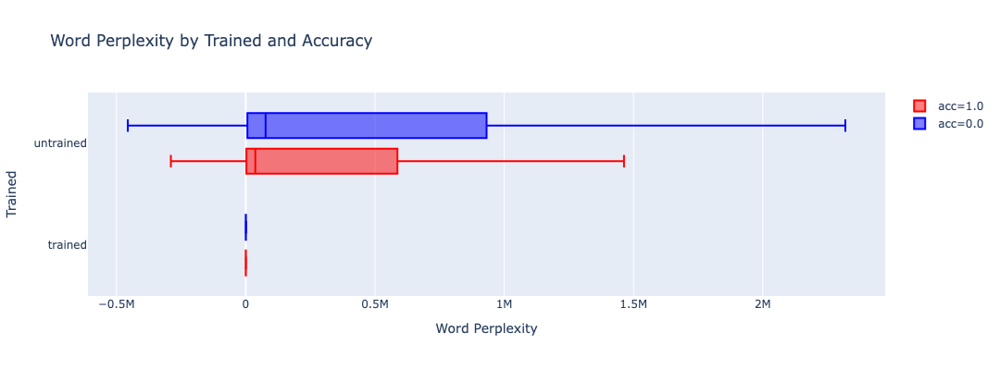

In [36]:
group_vars = ['trained','acc']
num_var = 'word_perplexity'
y_axis_var = 'trained'
color_var = 'acc'
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':get_title(group_vars, num_var, y_axis_var, color_var),
            'xaxis_title':get_axis_title(num_var),
            'yaxis_title':get_axis_title(y_axis_var),
            'boxmode':'group',
            'height': 400},
               order_by = '50%'
)

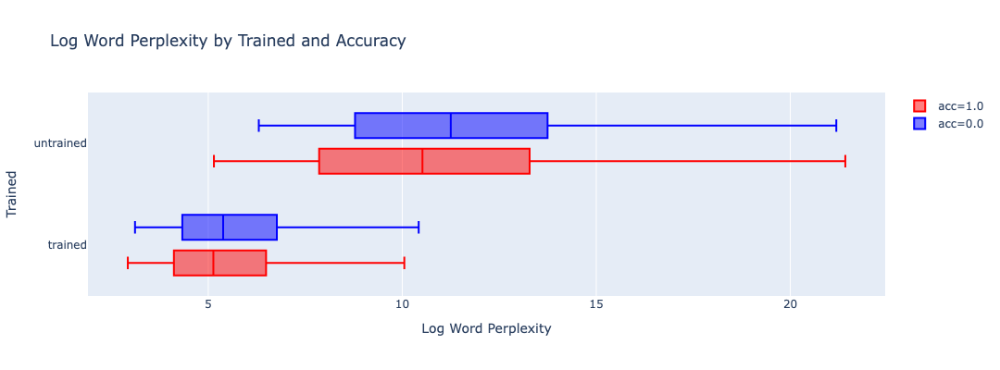

In [37]:
scaled_boxplot(df, group_vars=['trained','acc'], num_var = 'log_word_ppl', y_axis_var='trained',color_var='acc',
               layout_var={'title':'Log Word Perplexity by Trained and Accuracy',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Trained',
            'boxmode':'group',
            'height': 400},
               order_by = '50%'
)

In [7]:
grouped = df.groupby(['model', 'template'])['byte_perplexity'].agg([
    'min', 'q1', 'median', 'q3', 'max'
]).reset_index()

# Step 2: Create the box plot
fig = go.Figure()

for template in grouped['template'].unique():
    template_data = grouped[grouped['template'] == template]
    
    fig.add_trace(go.Box(
        x=template_data['model'],
        y=template_data['median'],
        name=f'Template {template}',
        lowerfence=template_data['min'],
        q1=template_data['q1'],
        median=template_data['median'],
        q3=template_data['q3'],
        upperfence=template_data['max'],
        marker_color='blue' if template == 0 else 'red'
    ))

# Customize the layout
fig.update_layout(
    title='Byte Perplexity by Model and Template',
    xaxis_title='Model',
    yaxis_title='Byte Perplexity',
    boxmode='group'
)

fig.show()

AttributeError: 'SeriesGroupBy' object has no attribute 'q1'

In [8]:
grouped = df.groupby(['model', 'template'])['byte_perplexity'].agg(['min', 'q1', 'median', 'q3', 'max']).reset_index()

AttributeError: 'SeriesGroupBy' object has no attribute 'q1'

In [11]:
len(df)

1103820

## Visualization focusing on word perplexity and byte perplexity

In [74]:

df['word_by_byte_ppl'] = df.apply(lambda x : x.word_perplexity/x.byte_perplexity, axis = 1)

df['log_word_by_byte_ppl'] = df.apply(lambda x : x.log_word_ppl/x.byte_perplexity, axis = 1)




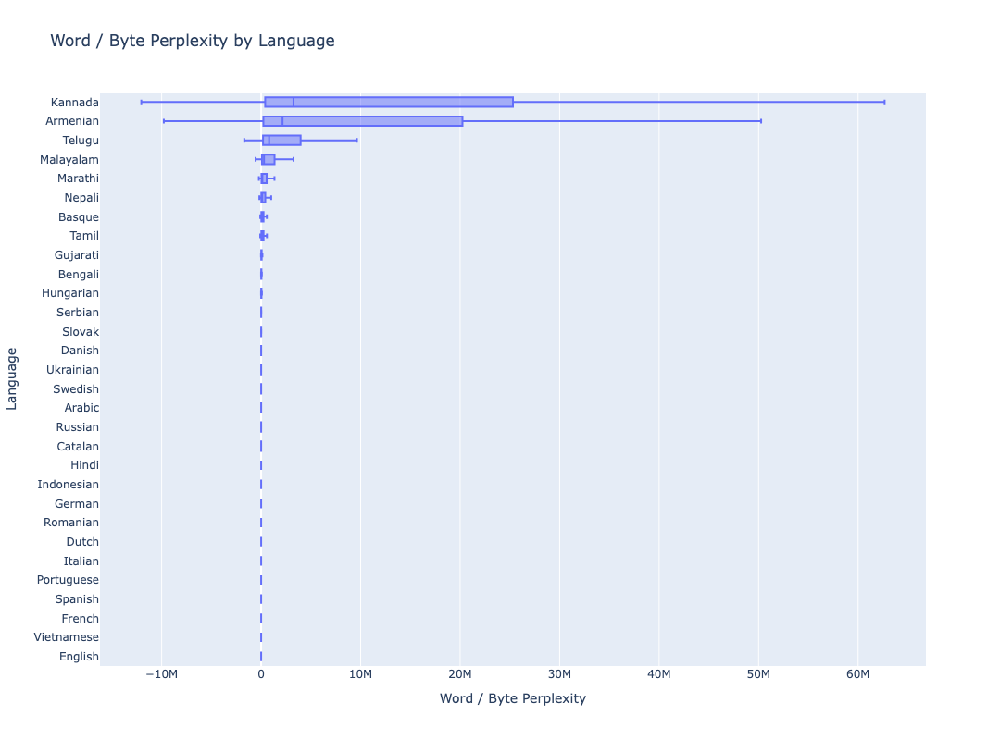

In [75]:
group_vars = ['lang']
num_var = 'word_by_byte_ppl'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':'Word / Byte Perplexity by Language',
            'xaxis_title':'Word / Byte Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

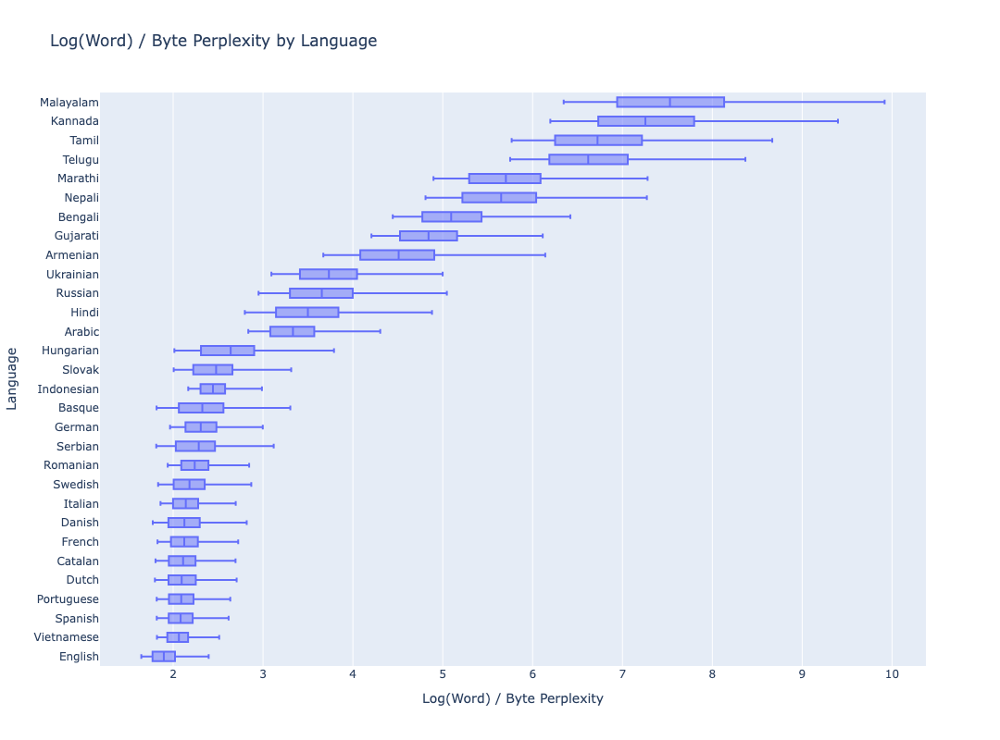

In [76]:
group_vars = ['lang']
num_var = 'log_word_by_byte_ppl'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':'Log(Word) / Byte Perplexity by Language',
            'xaxis_title':'Log(Word) / Byte Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

In [77]:
df[df.lang=='Malayalam'].log_word_by_byte_ppl.describe()

count    35732.000000
mean         7.548172
std          0.920257
min          2.321280
25%          6.940786
50%          7.528507
75%          8.131380
max         14.057095
Name: log_word_by_byte_ppl, dtype: float64

In [78]:
df[df.lang=='Malayalam'].word_by_byte_ppl.describe()

count    3.573200e+04
mean     6.753116e+09
std      8.836466e+11
min      1.267667e+02
25%      7.498545e+04
50%      2.879633e+05
75%      1.344848e+06
max      1.302072e+14
Name: word_by_byte_ppl, dtype: float64

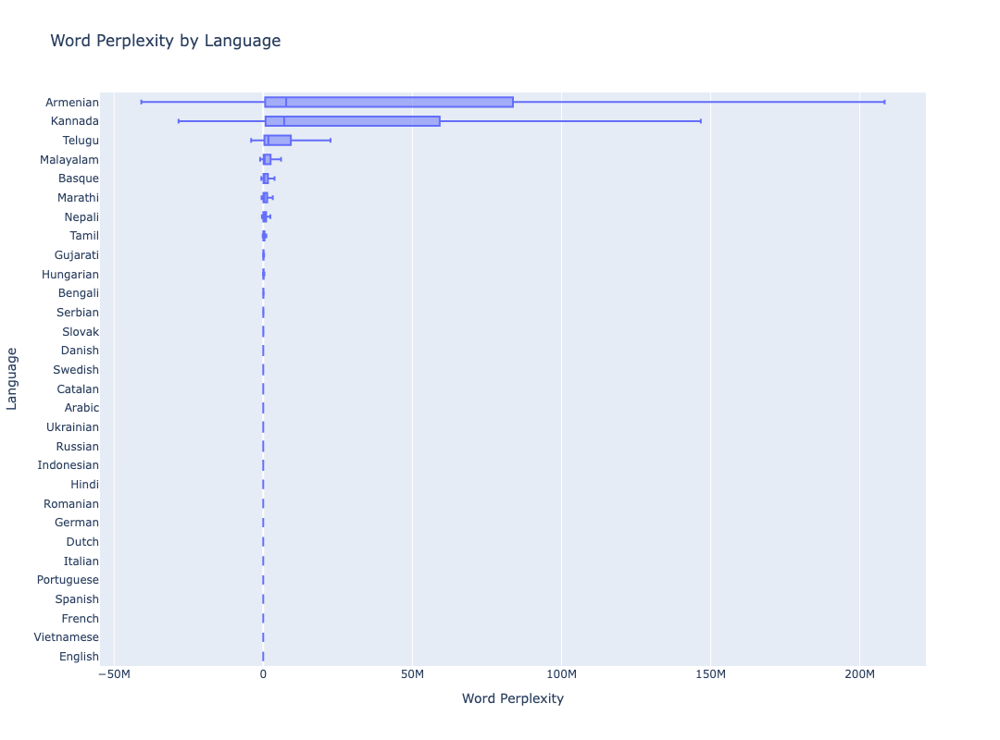

In [81]:
group_vars = ['lang']
num_var = 'word_perplexity'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':'Word Perplexity by Language',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

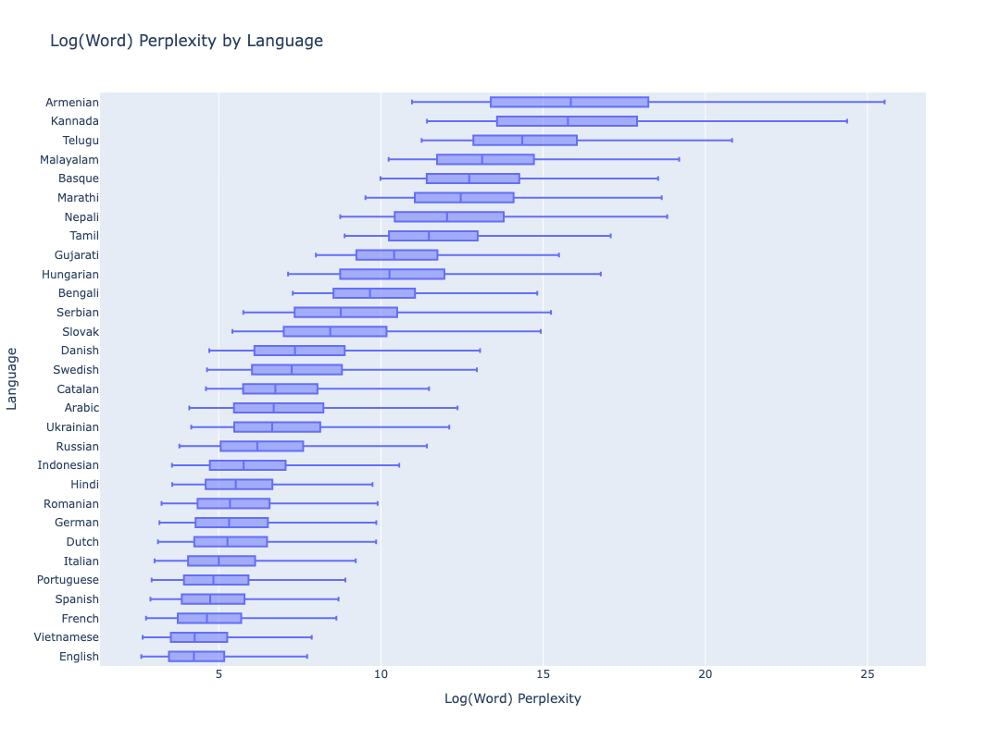

In [82]:
group_vars = ['lang']
num_var = 'log_word_ppl'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':'Log(Word) Perplexity by Language',
            'xaxis_title':'Log(Word) Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

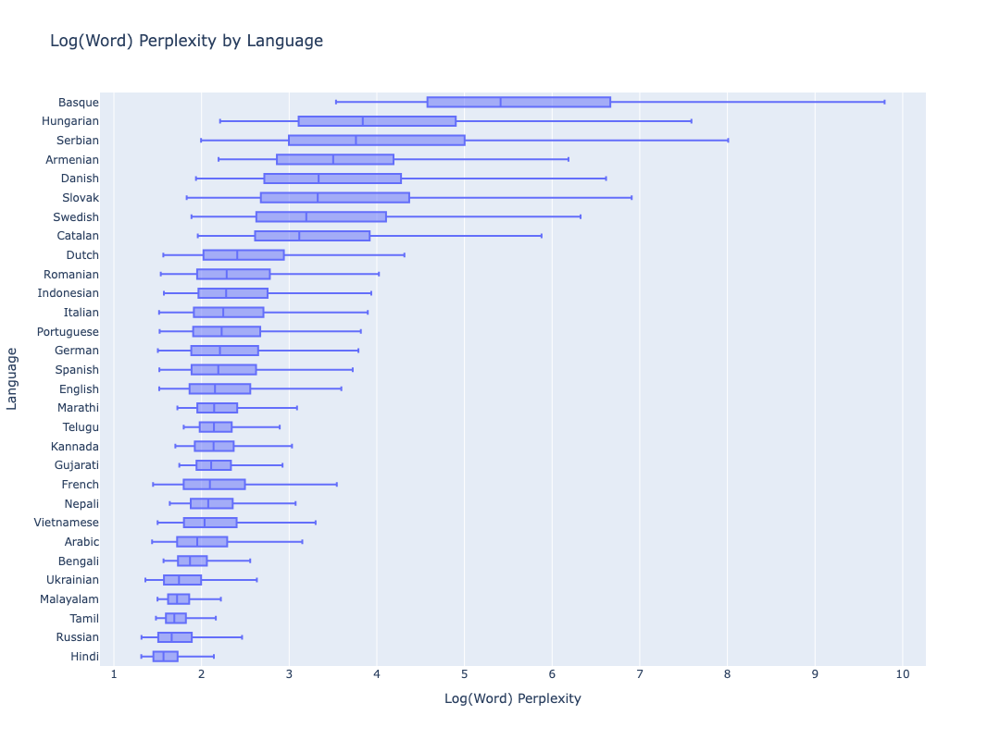

In [83]:
group_vars = ['lang']
num_var = 'byte_perplexity'
y_axis_var = 'lang'
color_var = None
    

scaled_boxplot(df, group_vars=group_vars, num_var = num_var, y_axis_var=y_axis_var,color_var=color_var,
               layout_var={'title':'Log(Word) Perplexity by Language',
            'xaxis_title':'Log(Word) Perplexity',
            'yaxis_title':'Language',
            'boxmode':'group',
            'height': 800},
               order_by = '50%'
)

## Statistical Test

### Without outlier removal

In [145]:
results = []

for lang in df.lang.unique():
    sub = df[df.lang==lang]

    output = [lang]

    for metric in ['word_perplexity','byte_perplexity','log_word_ppl']:
        
        is_significant, t_stat, p_value, g1mean, g2mean = compare_means(sub, 'acc', metric, display=False)

        output += [is_significant, t_stat, p_value, g1mean, g2mean, True if g2mean<g1mean else False]

    results.append(output)
    
results = pd.DataFrame(results)

In [149]:
results.columns =['lang',
                  'word_ppl','t_stat','p_val','acc = 0 mean','acc = 1 mean','word_ppl_trend',
                 'byte_ppl','t_stat','p_val','acc = 0 mean','acc = 1 mean','byte_ppl_trend',
                 'log_word_ppl','t_stat','p_val','acc = 0 mean','acc = 1 mean','log_word_ppl_trend'] 

results

,lang,word_ppl,t_stat,p_val,acc = 0 mean,acc = 1 mean,word_ppl_trend,byte_ppl,t_stat,p_val,acc = 0 mean,acc = 1 mean,byte_ppl_trend,log_word_ppl,t_stat,p_val,acc = 0 mean,acc = 1 mean,log_word_ppl_trend
0,Marathi,False,0.897470,0.369474,2.918896e+09,1.507871e+08,True,True,-8.012001,1.161295e-15,2.241777,2.290025,False,True,-3.688816,2.256220e-04,12.642347,12.756560,False
1,Gujarati,False,1.380735,0.167369,9.686008e+06,3.615016e+06,True,True,-9.111773,8.520478e-20,2.191347,2.241161,False,True,-5.508899,3.636067e-08,10.604907,10.744829,False
2,Russian,False,1.514865,0.129815,9.563420e+06,7.139235e+05,True,True,4.092607,4.274523e-05,1.808775,1.787169,True,True,5.330639,9.843907e-08,6.742873,6.612622,True
3,Dutch,False,-0.982464,0.325878,4.091185e+04,1.342515e+05,False,True,3.152596,1.619544e-03,2.757199,2.715161,True,True,4.662766,3.130735e-06,5.658601,5.566268,True
4,Telugu,False,-1.626264,0.103902,7.594442e+09,1.009670e+11,False,True,-7.941842,2.051367e-15,2.202880,2.239058,False,True,-6.337617,2.361913e-10,14.569083,14.768328,False
5,Portuguese,False,1.272706,0.203131,1.335005e+04,7.558132e+03,True,True,7.455373,9.157539e-14,2.555277,2.473304,True,True,8.582041,9.678293e-18,5.257909,5.101419,True
6,Catalan,False,1.841662,0.065533,1.501585e+05,8.302890e+04,True,True,5.594066,2.233843e-08,3.663237,3.555635,True,True,6.924906,4.434073e-12,7.182311,7.034996,True
7,Italian,False,-1.064277,0.287210,9.201241e+03,3.041863e+05,False,True,9.022715,1.921402e-19,2.590497,2.488985,True,True,10.580781,3.989758e-26,5.443498,5.244910,True
8,French,False,-0.146701,0.883369,9.684100e+03,1.060291e+04,False,True,6.415973,1.415981e-10,2.395279,2.329172,True,True,8.905746,5.536352e-19,5.051563,4.891734,True
9,Bengali,False,0.305587,0.759921,1.405848e+07,1.187319e+07,True,True,-9.336009,1.054226e-20,1.940107,1.979667,False,True,-7.579587,3.547460e-14,9.952509,10.145089,False


In [142]:
results[['word_perplexity','byte_perplexity','log_word_ppl']].sum()

word_perplexity     2
byte_perplexity    24
log_word_ppl       23
dtype: int64

In [154]:
results.groupby(['byte_ppl','byte_ppl_trend'])['lang'].count().reset_index()

,byte_ppl,byte_ppl_trend,lang
0,False,False,3
1,False,True,3
2,True,False,10
3,True,True,14


In [155]:
results.groupby(['word_ppl','word_ppl_trend'])['lang'].count().reset_index()

,word_ppl,word_ppl_trend,lang
0,False,False,14
1,False,True,14
2,True,False,2


In [156]:
results.groupby(['log_word_ppl','log_word_ppl_trend'])['lang'].count().reset_index()

,log_word_ppl,log_word_ppl_trend,lang
0,False,False,2
1,False,True,5
2,True,False,6
3,True,True,17


### With outlier removal

In [209]:
from functools import partial

remove_outliers_custom = partial(remove_outliers, lower_threshold = 0, upper_threshold = 99)

results = []

for lang in df.lang.unique():
    sub = df[df.lang==lang]

    output = [lang]

    for metric in ['word_perplexity','byte_perplexity','log_word_ppl']:
        
        mw_significant, t_significant, mw_pval, t_pval, g1mean, g2mean, g1median, g2median, g1perc25, g2perc25, g1perc75, g2perc75 = compare_means(sub, 'acc', metric, display=False, remove_outliers= remove_outliers_custom)

        output += [mw_significant, t_significant, mw_pval, t_pval, g1mean, g2mean, g1perc25, g2perc25, g1median, g2median, g1perc75, g2perc75, True if g2mean<g1mean else False]

    results.append(output)
    
results = pd.DataFrame(results)





In [210]:
results.columns =['lang',
                  'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','word_ppl_trend',
                 'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','byte_ppl_trend',
                 'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','log_word_ppl_trend'] 

results['trained'] = results.lang.apply(lambda x : 'trained' if x in trained_lang else 'untrained')

results

,lang,mw_significant,t_significant,mw_pval,t_pval,acc0_mean,acc1_mean,acc0_p25,acc1_p25,acc0_p50,...,acc0_mean,acc1_mean,acc0_p25,acc1_p25,acc0_p50,acc1_p50,acc0_p75,acc1_p75,log_word_ppl_trend,trained
0,Marathi,True,True,4.138835e-03,2.693564e-07,6.930406e+06,9.398420e+06,61647.697329,61471.227741,2.449327e+05,...,12.556645,12.634431,11.029191,11.026324,12.408739,12.489793,13.965667,14.149523,False,untrained
1,Gujarati,True,True,3.113512e-05,2.037700e-07,3.835446e+05,5.090506e+05,10089.594169,10574.747653,3.165963e+04,...,10.530399,10.641286,9.219260,9.266224,10.362798,10.439887,11.640241,11.806130,False,untrained
2,Russian,True,False,3.252376e-13,5.896231e-01,2.694666e+04,2.800065e+04,166.061038,145.673218,5.054415e+02,...,6.643958,6.508109,5.112355,4.981366,6.225432,6.095131,7.629100,7.414326,True,trained
3,Dutch,True,False,1.284073e-12,1.808876e-01,2.407158e+03,2.590272e+03,73.712153,64.633737,2.009230e+02,...,5.581522,5.478317,4.300168,4.168737,5.302922,5.185511,6.500268,6.380843,True,trained
4,Telugu,True,True,1.098106e-05,2.807471e-05,5.088767e+07,6.780151e+07,370690.455164,387129.656390,1.613026e+06,...,14.481370,14.633951,12.823123,12.866515,14.293622,14.418036,15.917288,16.123006,False,untrained
5,Portuguese,True,False,2.792749e-25,5.471523e-02,1.213530e+03,1.109891e+03,54.788529,46.518065,1.327241e+02,...,5.181814,5.029428,4.003481,3.839841,4.888272,4.761048,5.977198,5.778953,True,trained
6,Catalan,True,False,5.380658e-18,3.689130e-01,1.309374e+04,1.374120e+04,330.748302,281.579885,8.953946e+02,...,7.095802,6.960174,5.801358,5.640416,6.797265,6.628555,8.054994,7.894415,True,untrained
7,Italian,True,True,4.726657e-35,3.113011e-02,1.548226e+03,1.399090e+03,63.607832,51.928776,1.589407e+02,...,5.364244,5.172290,4.152737,3.949873,5.068531,4.897728,6.200628,5.956163,True,trained
8,French,True,False,9.162128e-35,9.837634e-01,9.025692e+02,9.017003e+02,45.761964,38.109510,1.111365e+02,...,4.979700,4.813577,3.823453,3.640464,4.710759,4.529340,5.762646,5.543534,True,trained
9,Bengali,True,True,1.600482e-09,1.833036e-10,2.932643e+05,4.322821e+05,4931.711198,5313.892978,1.483968e+04,...,9.869451,10.035892,8.503441,8.578080,9.605060,9.739008,10.939282,11.149437,False,untrained


In [211]:
results.to_csv('Stattest_results_outlier_treated.csv', index = False, index_label = False)

### Trained vs Untrained languages (with outlier removal)

In [215]:
from functools import partial

remove_outliers_custom = partial(remove_outliers, lower_threshold = 0, upper_threshold = 99)

results = []

for trained_value in df.trained.unique():
    sub = df[df.trained==trained_value]

    output = [trained_value]

    for metric in ['word_perplexity','byte_perplexity','log_word_ppl']:
        
        mw_significant, t_significant, mw_pval, t_pval, g1mean, g2mean, g1median, g2median, g1perc25, g2perc25, g1perc75, g2perc75 = compare_means(sub, 'acc', metric, display=False, remove_outliers= remove_outliers_custom)

        output += [mw_significant, t_significant, mw_pval, t_pval, g1mean, g2mean, g1perc25, g2perc25, g1median, g2median, g1perc75, g2perc75, True if g2mean<g1mean else False]

    results.append(output)
    
results = pd.DataFrame(results)


In [216]:
results.columns =['trained',
                  'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','word_ppl_trend',
                 'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','byte_ppl_trend',
                 'mw_significant', 't_significant', 'mw_pval','t_pval','acc0_mean','acc1_mean','acc0_p25','acc1_p25','acc0_p50','acc1_p50','acc0_p75','acc1_p75','log_word_ppl_trend'] 

# results['trained'] = results.lang.apply(lambda x : 'trained' if x in trained_lang else 'untrained')

results

,trained,mw_significant,t_significant,mw_pval,t_pval,acc0_mean,acc1_mean,acc0_p25,acc1_p25,acc0_p50,...,t_pval,acc0_mean,acc1_mean,acc0_p25,acc1_p25,acc0_p50,acc1_p50,acc0_p75,acc1_p75,log_word_ppl_trend
0,untrained,True,True,0.0,6.787407e-06,1.735190e+07,1.600049e+07,6347.686855,2521.274670,73411.370763,...,0.0,11.354088,10.740659,8.755846,7.832520,11.203834,10.469077,13.651933,13.184978,True
1,trained,True,True,0.0,9.570836e-08,4.623824e+03,4.247189e+03,75.185317,60.605842,212.993159,...,0.0,5.710161,5.484941,4.319956,4.104391,5.361260,5.110705,6.710436,6.435547,True


In [217]:
results.to_csv('Stattest_results_trained_vs_untrained_outlier_treated.csv', index = False, index_label = False)

## Case Study - Malayalam

In [118]:
sub = df[df.lang=='Malayalam']

### Word Perplexity by Accuracy

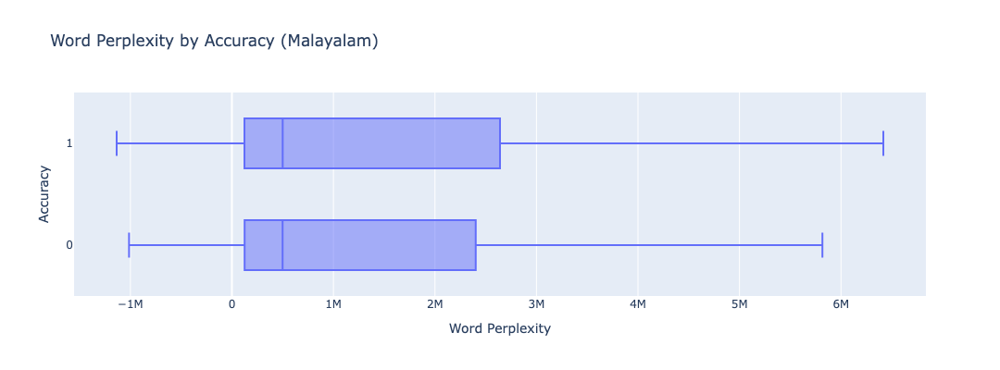

In [106]:
scaled_boxplot(sub, group_vars=['acc'], num_var='word_perplexity',y_axis_var='acc', layout_var={'title':'Word Perplexity by Accuracy (Malayalam)',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

### Log Word Perplexity by Accuracy

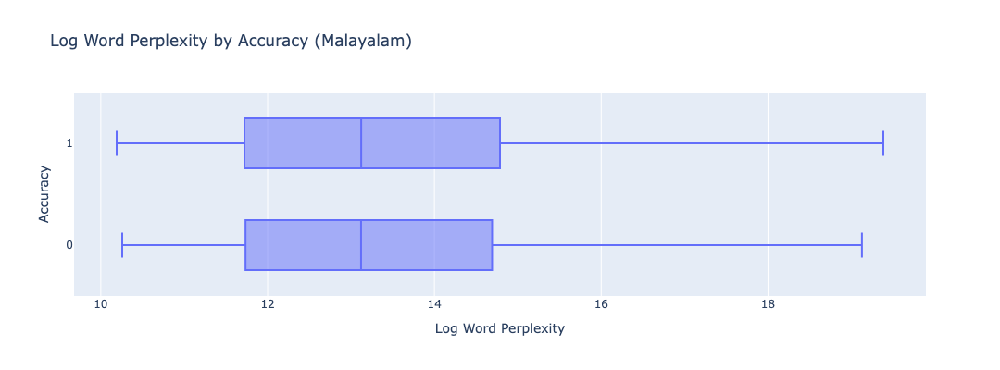

In [107]:
scaled_boxplot(sub, group_vars=['acc'], num_var='log_word_ppl',y_axis_var='acc', layout_var={'title':'Log Word Perplexity by Accuracy (Malayalam)',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

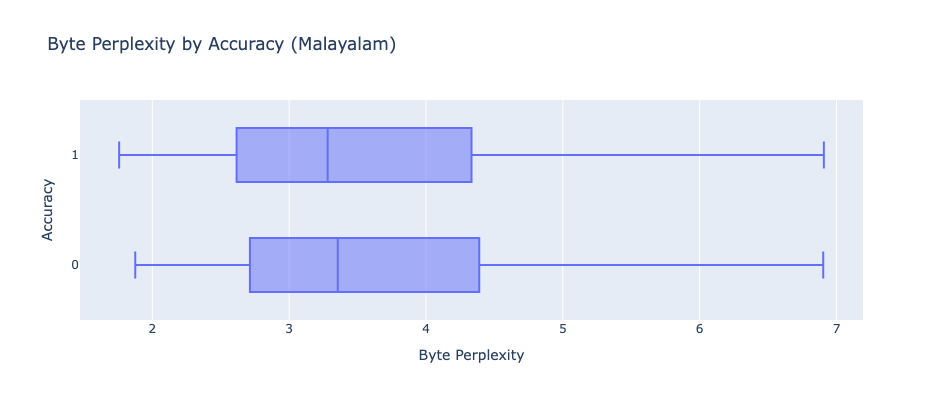

In [212]:
scaled_boxplot(sub, group_vars=['acc'], num_var='byte_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (Malayalam)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

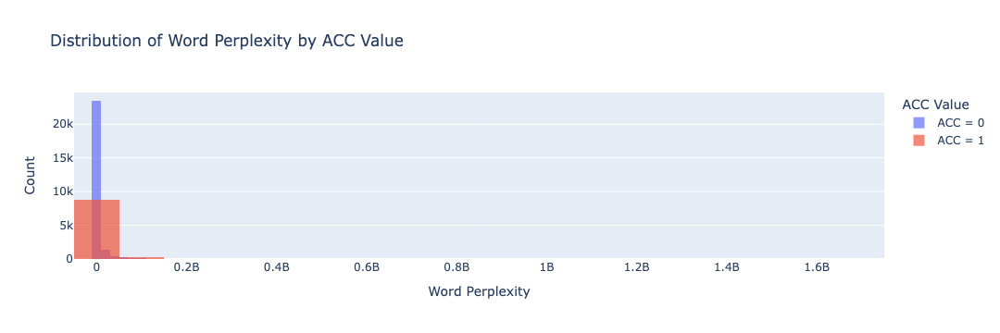

In [103]:
fig = go.Figure()

for acc_value in [0, 1]:
    subset = sub[sub['acc'] == acc_value]
    subset = remove_outliers(subset, 'word_perplexity',0,99)
    
    fig.add_trace(go.Histogram(
        x=subset['word_perplexity'],
        name=f'ACC = {acc_value}',
        opacity=0.7,
        nbinsx=30
    ))

# Update layout
fig.update_layout(
    title='Distribution of Word Perplexity by ACC Value',
    xaxis_title='Word Perplexity',
    yaxis_title='Count',
    barmode='overlay'
)

# Add a legend
fig.update_layout(legend_title='ACC Value')

# Show the plot
fig.show()

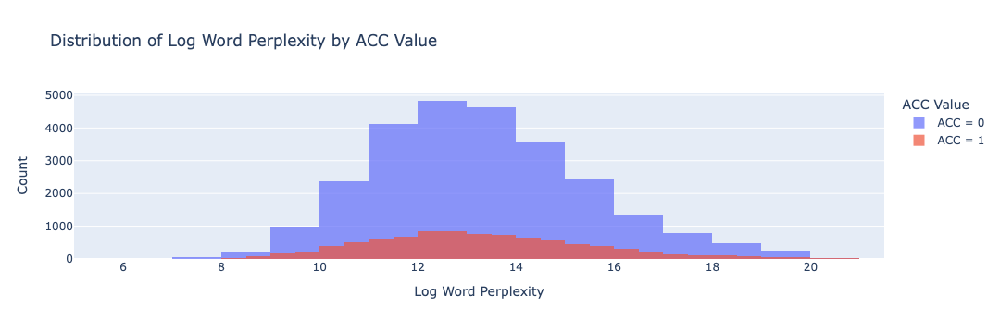

In [104]:
fig = go.Figure()

for acc_value in [0, 1]:
    subset = sub[sub['acc'] == acc_value]
    subset = remove_outliers(subset, 'log_word_ppl',0,99)
    
    fig.add_trace(go.Histogram(
        x=subset['log_word_ppl'],
        name=f'ACC = {acc_value}',
        opacity=0.7,
        nbinsx=30
    ))

# Update layout
fig.update_layout(
    title='Distribution of Log Word Perplexity by ACC Value',
    xaxis_title='Log Word Perplexity',
    yaxis_title='Count',
    barmode='overlay'
)

# Add a legend
fig.update_layout(legend_title='ACC Value')

# Show the plot
fig.show()

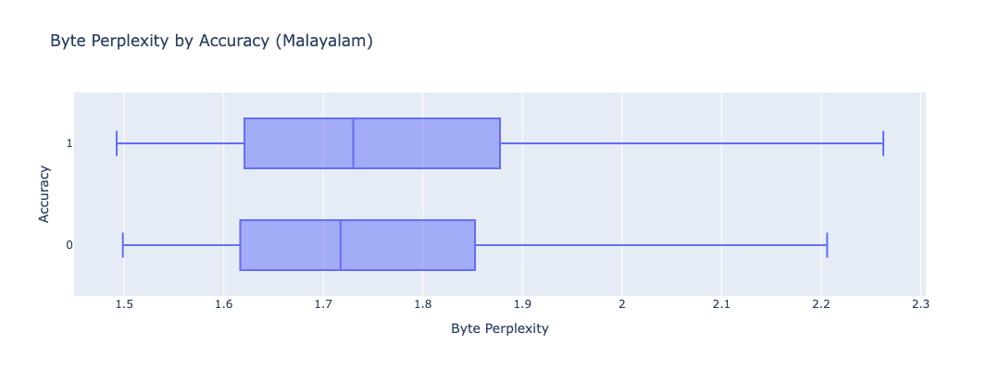

In [108]:
scaled_boxplot(sub, group_vars=['acc'], num_var='byte_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (Malayalam)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

### Statistical Test

In [119]:
for metric in ['word_perplexity','byte_perplexity','log_word_ppl']:
    print(f"Metric : {metric}")
    compare_means(sub, 'acc', metric)

Metric : word_perplexity
T-statistic: -2.4066696748410648
P-value: 0.016103765257097856
Mean for group 0: 312896954.1413858
Mean for group 1: 61087918499.3075
The difference in means is statistically significant at the 0.05 level.
Metric : byte_perplexity
T-statistic: -6.5739880599939085
P-value: 4.965871055176409e-11
Mean for group 0: 1.7681279139511075
Mean for group 1: 1.7881717431304516
The difference in means is statistically significant at the 0.05 level.
Metric : log_word_ppl
T-statistic: -1.917326217665193
P-value: 0.05520446591126824
Mean for group 0: 13.360246852776044
Mean for group 1: 13.415403047601556
The difference in means is not statistically significant at the 0.05 level.


## Case Study - English



In [109]:
sub = df[df.lang=='English']

### Word Perplexity by Accuracy

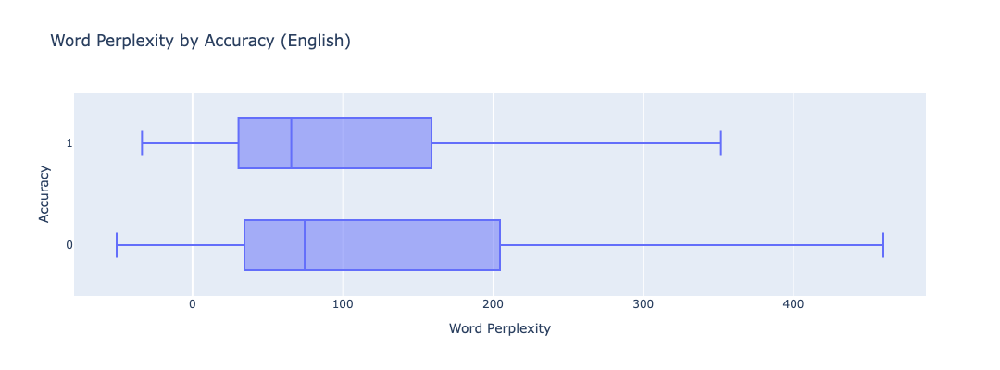

In [110]:
scaled_boxplot(sub, group_vars=['acc'], num_var='word_perplexity',y_axis_var='acc', layout_var={'title':'Word Perplexity by Accuracy (English)',
            'xaxis_title':'Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

### Log Word Perplexity by Accuracy

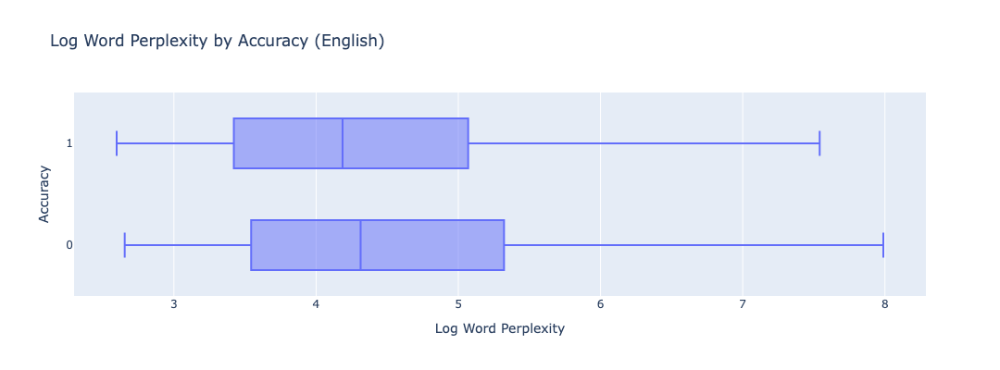

In [111]:
scaled_boxplot(sub, group_vars=['acc'], num_var='log_word_ppl',y_axis_var='acc', layout_var={'title':'Log Word Perplexity by Accuracy (English)',
            'xaxis_title':'Log Word Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

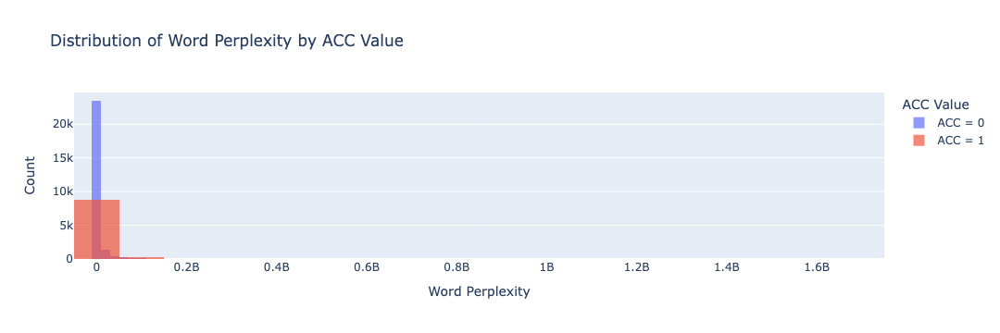

In [103]:
fig = go.Figure()

for acc_value in [0, 1]:
    subset = sub[sub['acc'] == acc_value]
    subset = remove_outliers(subset, 'word_perplexity',0,99)
    
    fig.add_trace(go.Histogram(
        x=subset['word_perplexity'],
        name=f'ACC = {acc_value}',
        opacity=0.7,
        nbinsx=30
    ))

# Update layout
fig.update_layout(
    title='Distribution of Word Perplexity by ACC Value',
    xaxis_title='Word Perplexity',
    yaxis_title='Count',
    barmode='overlay'
)

# Add a legend
fig.update_layout(legend_title='ACC Value')

# Show the plot
fig.show()

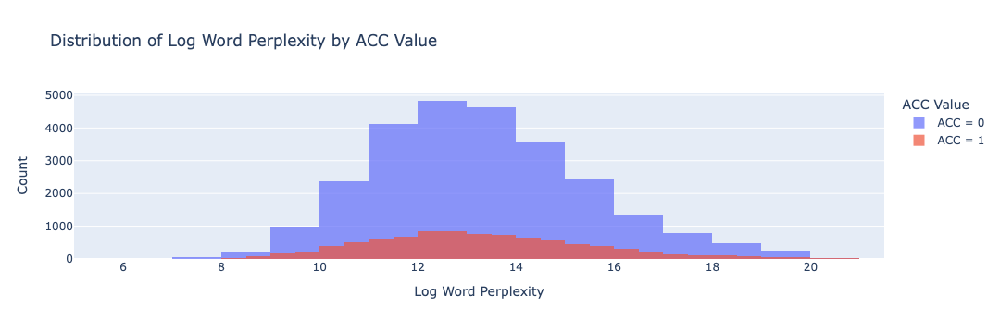

In [104]:
fig = go.Figure()

for acc_value in [0, 1]:
    subset = sub[sub['acc'] == acc_value]
    subset = remove_outliers(subset, 'log_word_ppl',0,99)
    
    fig.add_trace(go.Histogram(
        x=subset['log_word_ppl'],
        name=f'ACC = {acc_value}',
        opacity=0.7,
        nbinsx=30
    ))

# Update layout
fig.update_layout(
    title='Distribution of Log Word Perplexity by ACC Value',
    xaxis_title='Log Word Perplexity',
    yaxis_title='Count',
    barmode='overlay'
)

# Add a legend
fig.update_layout(legend_title='ACC Value')

# Show the plot
fig.show()

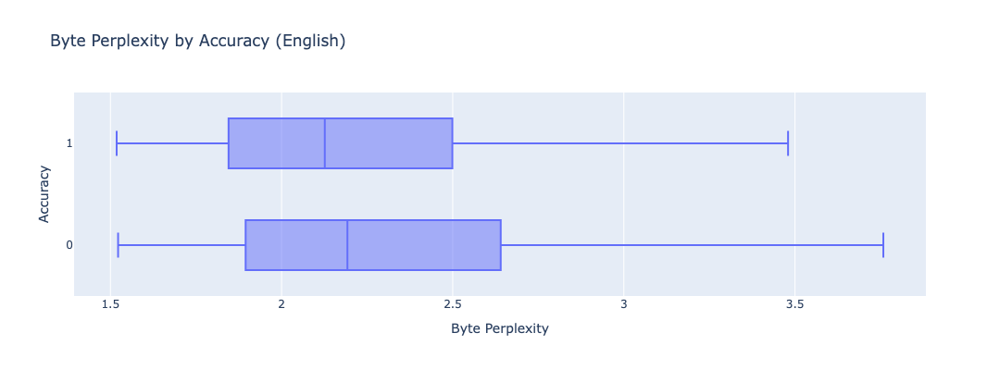

In [112]:
scaled_boxplot(sub, group_vars=['acc'], num_var='byte_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (English)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

### Statistical Test

In [117]:
for metric in ['word_perplexity','byte_perplexity','log_word_ppl']:
    print(f"Metric : {metric}")
    compare_means(sub, 'acc', metric)

Metric : word_perplexity
T-statistic: -0.9550648254203687
P-value: 0.33955066331938133
Mean for group 0: 1895.8849864957642
Mean for group 1: 2795.2807527058058
The difference in means is not statistically significant at the 0.05 level.
Metric : byte_perplexity
T-statistic: 7.349626861877711
P-value: 2.0253529135901977e-13
Mean for group 0: 2.4951645101813997
Mean for group 1: 2.413629977850893
The difference in means is statistically significant at the 0.05 level.
Metric : log_word_ppl
T-statistic: 8.702825684945884
P-value: 3.357872796560818e-18
Mean for group 0: 4.651810204956403
Mean for group 1: 4.510795192898074
The difference in means is statistically significant at the 0.05 level.


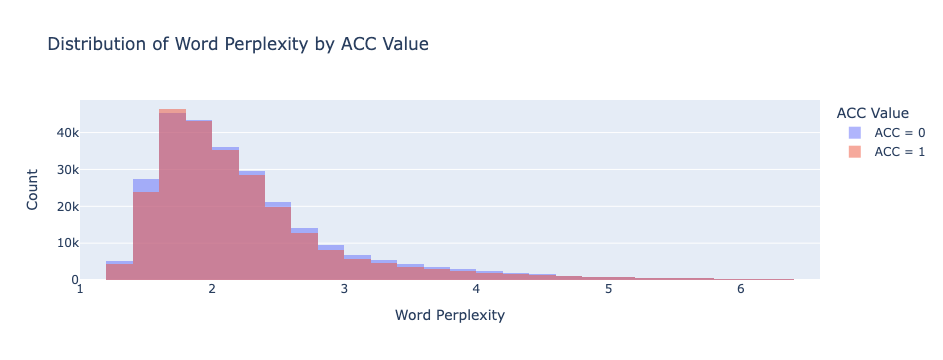

In [11]:
fig = go.Figure()
sub = df[df.trained == 'trained']

sub = remove_outliers(sub, 'byte_perplexity',0,99)

for acc_value in [0, 1]:
    subset = sub[sub['acc'] == acc_value]
    
    
    fig.add_trace(go.Histogram(
        x=subset['byte_perplexity'],
        name=f'ACC = {acc_value}',
        opacity=0.5,
        nbinsx=30
    ))

# Update layout
fig.update_layout(
    title='Distribution of Word Perplexity by ACC Value',
    xaxis_title='Word Perplexity',
    yaxis_title='Count',
    barmode='overlay'
)

# Add a legend
fig.update_layout(legend_title='ACC Value')

# Show the plot
fig.show()

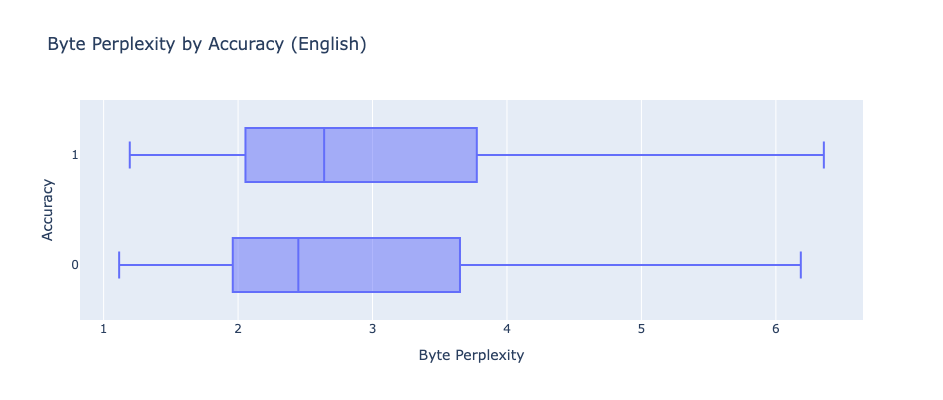

In [15]:
sub = df[df.trained == 'untrained']
scaled_boxplot(sub, group_vars=['acc'], num_var='byte_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (English)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

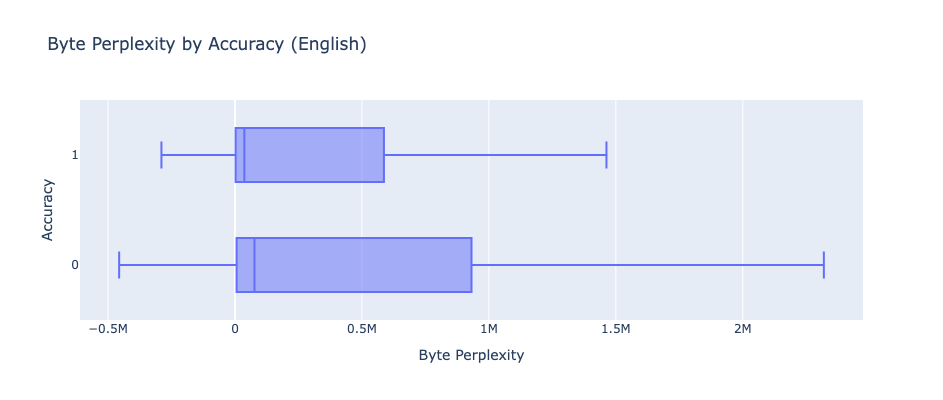

In [16]:

scaled_boxplot(sub, group_vars=['acc'], num_var='word_perplexity',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (English)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

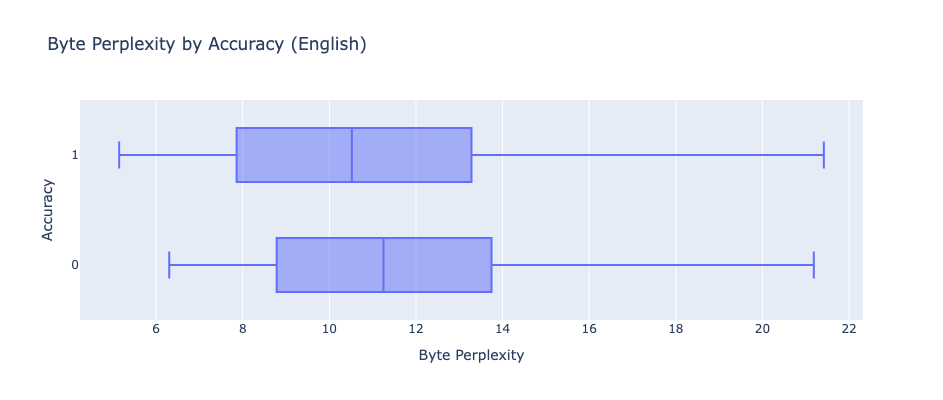

In [17]:
scaled_boxplot(sub, group_vars=['acc'], num_var='log_word_ppl',y_axis_var='acc', layout_var={'title':'Byte Perplexity by Accuracy (English)',
            'xaxis_title':'Byte Perplexity',
            'yaxis_title':'Accuracy',
            'boxmode':'group',
            'height': 400} )

In [18]:
sub.log_word_ppl.describe()

count    580608.000000
mean         11.285590
std           3.763805
min           2.621110
25%           8.485264
50%          11.048172
75%          13.614498
max          38.568878
Name: log_word_ppl, dtype: float64

In [19]:
sub.groupby('acc').log_word_ppl.describe()

,count,mean,std,min,25%,50%,75%,max
acc,,,,,,,,
0.0,401980.0,11.473074,3.703947,2.62111,8.783219,11.250132,13.744598,38.568878
1.0,178628.0,10.863682,3.862009,2.84070,7.858106,10.520230,13.282364,34.403866


In [20]:
sub.groupby('acc').word_perplexity.describe()

,count,mean,std,min,25%,50%,75%,max
acc,,,,,,,,
0.0,401980.0,2.695509e+11,9.515660e+13,13.750973,6523.843832,76890.092845,931543.107767,5.626664e+16
1.0,178628.0,1.642197e+10,2.614654e+12,17.127744,2586.617465,37057.662719,586755.758699,8.737944e+14


In [21]:
sub.groupby('acc').byte_perplexity.describe()

,count,mean,std,min,25%,50%,75%,max
acc,,,,,,,,
0.0,401980.0,3.145882,2.080713,1.234479,1.960406,2.448062,3.650423,72.312510
1.0,178628.0,3.320163,2.315008,1.244964,2.054815,2.640043,3.775599,126.800775
